# 📚 Transfer Learning Project with ResNet50 & MobileNet on TF Flowers


<a id="contents_tabel"></a>    

## 🗂 Table of Contents
1. [📦 Install & Import Dependencies](#install-import-dependencies)
2. [📸 Load and Preprocess TF Flowers Dataset](#load-and-preprocess-tf-flowers-dataset)
3. [🧱 Build ResNet50 Model](#build-resnet50-model)
4. [📱 Build MobileNet Model](#build-mobilenet-model)
5. [🛠️ Compile and Train](#compile-and-train)
6. [🎯 Fine-Tune Strategy A (Layer-Based)](#fine-tune-strategy-a-layer-based)
7. [🔧 Fine-Tune Strategy B (Block-Based)](#fine-tune-strategy-b-block-based)
8. [🖼️ Image Reverse Preprocessing Functions](#reverse-preprocessing)
9. [📊 Evaluate Model](#evaluate-model)
10. [📈 Plot Learning Curves](#plot-learning-curves)
11. [📸 Display Examples Utility](#display-examples-utility)
12. [🧪 Transfer Learning Experiment Runner](#experiment-runner)
13. [🧠Model Architectures](#model-architectures)
14. [📊 Transfer Learning Comparison Initialization](#transfer-learning-init)
15. [🔁Running Transfer Learning Experiments](#running-transfer-learning-experiments)
16. [📊Summary of Results](#summary-of-results)


<a id="install-import-dependencies"></a>
## 1. 📦 Install & Import Dependencies

⬆️ [Tabel of Contents](#contents_tabel)

Installs and imports necessary libraries like `tensorflow`, `visualkeras`, and others.  
Sets random seeds for reproducibility.

In [ ]:
!pip install visualkeras

In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np
import time
from PIL import Image

# Import necessary preprocessing functions
from tensorflow.keras.applications.resnet50 import preprocess_input as resnet_preprocess
from tensorflow.keras.applications.mobilenet import preprocess_input as mobilenet_preprocess

from tensorflow.keras.utils import plot_model
import visualkeras

**🔁 Set Random Seeds for Reproducibility**

Setting seeds is a crucial step in machine learning experiments to ensure **reproducibility** — that is, getting the same results every time you run the code.


In [ ]:
np.random.seed(42)
tf.random.set_seed(42)

<a id="load-and-preprocess-tf-flowers-dataset"></a>

## 2. 📸 Load and Preprocess TF Flowers Dataset

⬆️ [Tabel of Contents](#contents_tabel)

The code defines a function `load_and_prepare_tf_flowers_numpy` that helps in loading and preprocessing the TF Flowers dataset. This dataset consists of images of flowers, and the function is designed to load these images, resize them, and optionally apply some preprocessing steps suitable for different deep learning models.

### Function Overview:
- **`img_size=(224, 224)`**: Specifies the target size for each image after resizing. By default, it resizes the images to 224x224 pixels, which is a common input size for models like ResNet50 and MobileNet.
  
- **`preprocessing_fn=None`**: Optionally, you can pass a preprocessing function. This function will be applied to the images before returning them. Preprocessing functions are often used to normalize or standardize the images according to the requirements of specific models.

### Code Breakdown:

1. **Define Dataset Splits**:
   The `splits` variable is used to specify the subsets of the dataset:
   - `train[:10%]`: First 10% of the training set.
   - `train[10%:25%]`: Next 15% of the training set (for validation).
   - `train[25%:]`: Remaining 75% of the training set (for actual training).

2. **Load the Dataset Using TensorFlow Datasets**:
   `tfds.load("tf_flowers", ...)` is used to load the TF Flowers dataset. The `split` argument allows us to specify how we want the data divided (e.g., into training, validation, and test sets).
   - The `as_supervised=True` flag means that the data will be loaded as pairs of `(image, label)`.

3. **Function to Convert TensorFlow Dataset to NumPy Arrays**:
   Inside the `load_and_prepare_tf_flowers_numpy` function, there is another helper function `dataset_to_numpy`. This function is responsible for:
   - Iterating over each image and label in the TensorFlow dataset.
   - Converting the image from a TensorFlow tensor to a NumPy array using `img.numpy()`.
   - Resizing the image to the desired `img_size` using the `PIL.Image` library.
   - Collecting all images and their corresponding labels into lists, and finally converting these lists into NumPy arrays.

4. **Convert Training, Validation, and Test Sets**:
   The function calls `dataset_to_numpy` for each dataset split (train, validation, test) to convert them into NumPy arrays.

5. **Apply Preprocessing (Optional)**:
   If a `preprocessing_fn` function is provided, it is applied to the images in all three sets (train, validation, test). This function is useful if you want to apply model-specific transformations (e.g., normalization, color adjustments).

6. **Get Class Names**:
   The `class_names` are extracted from the dataset metadata (`info.features["label"].names`). These represent the flower species present in the dataset.

### Returns:
The function returns four objects:
- **`train_images, train_labels`**: Training images and their corresponding labels.
- **`valid_images, valid_labels`**: Validation images and their corresponding labels.
- **`test_images, test_labels`**: Test images and their corresponding labels.
- **`class_names`**: A list of flower species class names.


In [ ]:
def load_and_prepare_tf_flowers_numpy(img_size=(224, 224), preprocessing_fn=None):
    """
    Load and prepare the TF Flowers dataset using NumPy.

    Args:
        img_size: Target image size (height, width). Default is (224, 224).
        preprocessing_fn: The preprocessing function to use for the specific model.

    Returns:
        train_images, train_labels: Training set (images and labels)
        valid_images, valid_labels: Validation set (images and labels)
        test_images, test_labels: Test set (images and labels)
        class_names: List of class names
    """
    # Define the splits
    splits = ["train[:10%]", "train[10%:25%]", "train[25%:]"]

    # Load the dataset
    (test_set_raw, valid_set_raw, train_set_raw), info = tfds.load(
        "tf_flowers", split=splits, as_supervised=True, with_info=True
    )

    # Function to resize and convert a tf.data.Dataset to NumPy arrays
    def dataset_to_numpy(dataset, img_size):
        images, labels = [], []
        for img, label in dataset:
            # Convert TensorFlow tensor to NumPy array
            img = img.numpy()
            # Resize the image to the target size
            img = np.array(Image.fromarray(img).resize(img_size))
            images.append(img)
            labels.append(label.numpy())
        return np.array(images), np.array(labels)

    # Convert datasets to NumPy arrays
    train_images, train_labels = dataset_to_numpy(train_set_raw, img_size)
    valid_images, valid_labels = dataset_to_numpy(valid_set_raw, img_size)
    test_images, test_labels = dataset_to_numpy(test_set_raw, img_size)

    # Apply preprocessing function if provided
    if preprocessing_fn is not None:
        train_images = preprocessing_fn(train_images)
        valid_images = preprocessing_fn(valid_images)
        test_images = preprocessing_fn(test_images)

    # Get class names
    class_names = info.features["label"].names

    return (train_images, train_labels), (valid_images, valid_labels), (test_images, test_labels), class_names

<a id="build-resnet50-model"></a>

## 3. 🧱 Build ResNet50 Model

⬆️ [Tabel of Contents](#contents_tabel)




The function `build_resnet50_model` loads a pretrained `ResNet50` model from ImageNet without the top classification layer, adds custom classification layers, freezes the base model initially, and visualizes the model using `visualkeras`.

### Function Overview:
- **`input_shape`**: Specifies the input image shape (height, width, channels). It defines the dimensions of the image the model will accept.
- **`n_classes`**: Specifies the number of output classes for the classification task. This will define the number of neurons in the output layer.

### Code Breakdown:

1. **Load Pretrained ResNet50 Model**:
   The `tf.keras.applications.ResNet50` function is used to load the ResNet50 model that was pretrained on the ImageNet dataset.
   - `weights="imagenet"`: Loads the model with weights trained on ImageNet.
   - `include_top=False`: Excludes the top classification layer of the ResNet50 model.
   - `input_shape=input_shape`: Specifies the input shape for the model.

2. **Visualize the Model**:
   Using the `visualkeras.layered_view` function, a layered visualization of the ResNet50 model is generated. This helps in understanding the architecture and the layers of the model. The visualized model is saved as an image file (`resnet50_layered_view.png`) and displayed.

3. **Freeze Base Model Layers**:
   The base model (ResNet50) is initially frozen by setting `base_model.trainable = False`. This means the weights of the ResNet50 layers will not be updated during training, preserving the pretrained features.

4. **Create Model Inputs and Apply Base Model**:
   - `inputs = tf.keras.Input(shape=input_shape)`: Defines the input layer with the specified shape.
   - `x = base_model(inputs, training=False)`: Applies the base ResNet50 model to the input data.

5. **Add Custom Classification Layers**:
   - **Global Average Pooling**: The `GlobalAveragePooling2D()` layer reduces the spatial dimensions of the output from the ResNet50 model to a single vector.
   - **Dropout Layer**: The `Dropout(0.2)` layer is added to prevent overfitting by randomly setting 20% of the neurons to zero during training.
   - **Dense Output Layer**: The `Dense(n_classes, activation="softmax")` layer is added as the final layer. It outputs the probability distribution over the `n_classes` using the softmax activation function.

6. **Create Full Model**:
   The complete model is created using the `tf.keras.Model(inputs=inputs, outputs=outputs)` method, which combines the input layer, the ResNet50 base model, and the custom classification layers.

7. **Print Model Information**:
   The function prints out information about the model structure:
   - Total number of layers in the model.
   - Whether the base model layers are trainable.
   - The number of trainable and non-trainable weights in the model.

8. **Analyze ResNet50 Layer Structure**:
   The code loops through the layers of the base ResNet50 model and groups them by their block name. It then prints out the layers in each block, providing a deeper insight into the structure of the ResNet50 model.

### Returns:
The function returns the compiled Keras model, which is ready for training with the custom classification layers on top of the pretrained ResNet50 base.

In [ ]:
def build_resnet50_model(input_shape, n_classes):
    """
    Build a model based on pretrained ResNet50 architecture.
    Initially freezes pretrained layers.

    Args:
        input_shape: Input image shape (height, width, channels)
        n_classes: Number of output classes

    Returns:
        Compiled Keras model ready for training
    """




    # Load ResNet50 model pretrained on ImageNet without the classification head
    base_model = tf.keras.applications.ResNet50(
        weights="imagenet",
        include_top=False,
        input_shape=input_shape
    )


    # Create a layered view visualization
    img=visualkeras.layered_view(base_model, to_file='resnet50_layered_view.png', legend=True)
    img.show()
    # Freeze the base model first
    base_model.trainable = False

    # Create the inputs and apply the base model
    inputs = tf.keras.Input(shape=input_shape)
    x = base_model(inputs, training=False)

    # Add global average pooling and dense classification layer
    x = tf.keras.layers.GlobalAveragePooling2D()(x)

    # Add a dropout layer to prevent overfitting
    x = tf.keras.layers.Dropout(0.2)(x)

    # Add final dense layer with softmax
    outputs = tf.keras.layers.Dense(n_classes, activation="softmax")(x)

    # Create the full model
    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    # Print model layer information
    print("=== ResNet50 Model Structure ===")
    print(f"Total layers in model: {len(model.layers)}")
    print(f"Base model trainable: {base_model.trainable}")
    print(f"Trainable weights: {len(model.trainable_weights)}")
    print(f"Non-trainable weights: {len(model.non_trainable_weights)}")

    # Analyze ResNet50 layer structure
    print("\nResNet50 Layer Groups:")
    layer_groups = {}
    for i, layer in enumerate(base_model.layers):
        # Extract block information from layer name
        if 'conv' in layer.name:
            block_name = layer.name.split('_')[0]
            if block_name not in layer_groups:
                layer_groups[block_name] = []
            layer_groups[block_name].append(i)

    for block, layers in layer_groups.items():
        print(f"{block}: Layers {min(layers)}-{max(layers)} (Total: {len(layers)})")

    return model


<a id="build-mobilenet-model"></a>

## 4. 📱 Build MobileNet Model

⬆️ [Tabel of Contents](#contents_tabel)



The function `build_mobilenet_model` follows a similar structure and functionality to the ResNet model but uses `MobileNet` as the base model. The MobileNet architecture is often preferred for mobile and embedded applications due to its lightweight nature. This function loads the pretrained MobileNet model, adds custom classification layers, freezes the base model initially, and visualizes the architecture using `visualkeras`.

### Function Overview:
- **`input_shape`**: Specifies the input shape of the image (height, width, channels). This is the size of the image that will be passed through the model.
- **`n_classes`**: Specifies the number of output classes. It defines how many categories the model needs to classify the input images into.

### Code Breakdown:

1. **Load Pretrained MobileNet Model**:
   The `tf.keras.applications.MobileNet` function is used to load the MobileNet model pretrained on the ImageNet dataset.
   - `weights="imagenet"`: Loads the weights that were trained on ImageNet.
   - `include_top=False`: Excludes the top classification layer of MobileNet, so we can add our custom classification layers.
   - `input_shape=input_shape`: Specifies the input shape for the model.

2. **Visualize the Model**:
   The `visualkeras.layered_view` function generates a visualization of the MobileNet model's architecture. The model is saved as an image (`mobilenet_layered_view.png`) and displayed to give an insight into the structure of the model.

3. **Freeze Base Model Layers**:
   The MobileNet base model is initially frozen by setting `base_model.trainable = False`. This prevents the model from updating the weights of the pretrained layers during the training process. Only the custom layers added later will be trained.

4. **Create Model Inputs and Apply Base Model**:
   - `inputs = tf.keras.Input(shape=input_shape)`: Defines the input layer for the model with the specified shape.
   - `x = base_model(inputs, training=False)`: Passes the inputs through the pretrained MobileNet base model.

5. **Add Custom Classification Layers**:
   - **Global Average Pooling**: The `GlobalAveragePooling2D()` layer reduces the spatial dimensions (height and width) of the output from the base model into a single vector, which is easier to process by the dense layer.
   - **Dropout Layer**: The `Dropout(0.2)` layer helps in regularization by randomly setting 20% of the neurons to zero during training, which prevents overfitting.
   - **Dense Output Layer**: The `Dense(n_classes, activation="softmax")` layer is the final output layer. It outputs a probability distribution over the `n_classes` using the softmax activation function.

6. **Create Full Model**:
   The complete model is created using the `tf.keras.Model(inputs=inputs, outputs=outputs)` function. This combines the input layer, the base MobileNet model, and the custom classification layers into a single model.

7. **Print Model Information**:
   The function prints the structure of the model:
   - Total number of layers in the model.
   - Whether the base model layers are trainable.
   - Number of trainable and non-trainable weights in the model.

8. **Analyze MobileNet Layer Structure**:
   The code iterates through the layers of the MobileNet base model, grouping them by their block name. It then prints out the layers in each block, helping to understand the architecture of the MobileNet model more deeply.

### Returns:
The function returns the compiled Keras model, which is ready for training with the custom classification layers built on top of the pretrained MobileNet model.

In [ ]:
def build_mobilenet_model(input_shape, n_classes):
    """
    Build a model based on pretrained MobileNet architecture.
    Initially freezes pretrained layers.

    Args:
        input_shape: Input image shape (height, width, channels)
        n_classes: Number of output classes

    Returns:
        Compiled Keras model ready for training
    """
    # Load MobileNet model pretrained on ImageNet without the classification head
    base_model = tf.keras.applications.MobileNet(
        weights="imagenet",
        include_top=False,
        input_shape=input_shape
    )

    img=visualkeras.layered_view(base_model, to_file='mobilenet_layered_view.png', legend=True)
    img.show()

    # Freeze the base model first
    base_model.trainable = False

    # Create the inputs and apply the base model
    inputs = tf.keras.Input(shape=input_shape)
    x = base_model(inputs, training=False)

    # Add global average pooling and dense classification layer
    x = tf.keras.layers.GlobalAveragePooling2D()(x)

    # Add a dropout layer to prevent overfitting
    x = tf.keras.layers.Dropout(0.2)(x)

    # Add final dense layer with softmax
    outputs = tf.keras.layers.Dense(n_classes, activation="softmax")(x)

    # Create the full model
    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    # Print model layer information
    print("=== MobileNet Model Structure ===")
    print(f"Total layers in model: {len(model.layers)}")
    print(f"Base model trainable: {base_model.trainable}")
    print(f"Trainable weights: {len(model.trainable_weights)}")
    print(f"Non-trainable weights: {len(model.non_trainable_weights)}")

    # Analyze MobileNet layer structure
    print("\nMobileNet Layer Groups:")
    layer_groups = {}
    for i, layer in enumerate(base_model.layers):
        # Extract block information from layer name
        if 'conv' in layer.name:
            # MobileNet has a different naming convention
            block_name = 'conv_' + layer.name.split('_')[1] if '_' in layer.name else 'conv_base'
            if block_name not in layer_groups:
                layer_groups[block_name] = []
            layer_groups[block_name].append(i)

    for block, layers in layer_groups.items():
        print(f"{block}: Layers {min(layers)}-{max(layers)} (Total: {len(layers)})")

    return model

<a id="compile-and-train"></a>

## 5. 🛠️ Compile and Train

⬆️ [Tabel of Contents](#contents_tabel)



The function `compile_and_train_model` is responsible for compiling and training the model, while keeping the base layers frozen. This allows the custom layers added on top of the pretrained model to be trained while the underlying base model layers remain unchanged. It also uses early stopping and a custom learning rate to prevent overfitting and ensure the model doesn't train too long.

### Function Overview:
- **`model`**: The Keras model that will be trained.
- **`train_images`**: A NumPy array containing the training images.
- **`train_labels`**: A NumPy array containing the training labels corresponding to the images.
- **`valid_images`**: A NumPy array containing the validation images.
- **`valid_labels`**: A NumPy array containing the validation labels.
- **`epochs`**: The number of training epochs (default is 3). This is how many times the model will iterate over the entire dataset.
- **`lr`**: The learning rate for the optimizer (default is 0.001). A lower learning rate can help the model learn more slowly but steadily.

### Code Breakdown:

1. **Phase 1 - Training with Frozen Base Model**:
   The function starts by indicating that Phase 1 of the training process will involve training only the custom layers while keeping the base model layers frozen.

2. **Optimizer**:
   The `tf.keras.optimizers.Adam` optimizer is used with a learning rate of `0.0001`. Adam is an adaptive optimizer, which means it adjusts the learning rate based on the gradients, helping to improve convergence during training.
   - `learning_rate=0.0001`: The custom learning rate passed to the optimizer.

3. **Compile the Model**:
   The `model.compile` function is called to configure the model for training. It sets the following parameters:
   - `loss="sparse_categorical_crossentropy"`: The loss function used for multi-class classification problems. Sparse categorical cross-entropy is used when the labels are integers instead of one-hot encoded vectors.
   - `optimizer=optimizer`: The optimizer used for updating the model's weights.
   - `metrics=["accuracy"]`: The metric to track during training. In this case, it tracks the accuracy of the model’s predictions.

4. **Train the Model**:
   The `model.fit` function is called to train the model. It takes in:
   - `train_images, train_labels`: The training data and corresponding labels.
   - `validation_data=(valid_images, valid_labels)`: The validation data and labels, used to evaluate the model at the end of each epoch.
   - `epochs=epochs`: The number of epochs to train the model. This is set to 3 by default but can be adjusted.
   - `callbacks=[tf.keras.callbacks.EarlyStopping(patience=2, restore_best_weights=True)]`: The EarlyStopping callback monitors the validation loss. If there is no improvement in the validation loss for 2 consecutive epochs (`patience=2`), training will stop early to prevent overfitting, and the model will restore the best weights seen during training.

### Returns:
- **`history`**: The `history` object, which contains information about the training process, such as loss and accuracy for each epoch. This can be used to visualize training progress or analyze the model's performance.

In [ ]:
def compile_and_train_model(model, train_images, train_labels, valid_images, valid_labels, epochs=3, lr=0.001):
    """
    Compile and train the model with initial frozen layers using NumPy arrays.

    Args:
        model: Keras model to train
        train_images: Training images (NumPy array)
        train_labels: Training labels (NumPy array)
        valid_images: Validation images (NumPy array)
        valid_labels: Validation labels (NumPy array)
        epochs: Number of epochs to train (default is 3)
        lr: Learning rate (default is 0.001)

    Returns:
        Training history
    """
    print("\n--- Phase 1: Training with frozen base model ---")

    # Use Adam optimizer with momentum
    optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)

    # Compile the model
    model.compile(
        loss="sparse_categorical_crossentropy",
        optimizer=optimizer,
        metrics=["accuracy"]
    )

    # Train the model using NumPy arrays
    history = model.fit(
        train_images, train_labels,
        validation_data=(valid_images, valid_labels),
        epochs=epochs,
        callbacks=[tf.keras.callbacks.EarlyStopping(patience=2, restore_best_weights=True)]
    )

    return history

<a id="fine-tune-strategy-a-layer-based"></a>

## 6. 🎯 Fine-Tune Strategy A (Layer-Based)

⬆️ [Tabel of Contents](#contents_tabel)



The function `fine_tune_model_strategy_A` is designed to fine-tune a pretrained model by selectively unfreezing a specific number of layers from the base model. This strategy allows for a fine-grained control over the fine-tuning process, enabling experimentation with different unfreeze configurations. The function clones the model for each unfreezing trial to avoid cumulative fine-tuning, making it a useful technique to understand the impact of layer-wise adjustments on model performance.

### Function Overview:
- **`model`**: The pretrained Keras model that we will fine-tune by unfreezing some of its layers.
- **`train_images`, `train_labels`**: The training data (images and corresponding labels).
- **`valid_images`, `valid_labels`**: The validation data (images and corresponding labels).
- **`unfreeze_layers_list`**: A list of different configurations for how many layers from the end of the base model to unfreeze.
- **`lr`**: The learning rate to use during training. Default is `0.0001`.
- **`epochs`**: The number of epochs to train the model. Default is `15`.

### Code Breakdown:

1. **Initialize Histories**:
   The `histories` dictionary is created to store the training history for each unfreeze configuration. This allows you to compare the impact of different unfreeze settings on the model's performance.

2. **Iterate Over Unfreeze Layer Configurations**:
   The function iterates over the `unfreeze_layers_list`, which contains different numbers of layers to unfreeze. Each configuration is treated as a separate experiment, and the model is cloned to ensure that no previous fine-tuning settings carry over.

3. **Clone Model and Set Base Model**:
   - The model is cloned using `tf.keras.models.clone_model()` to ensure that each experiment starts with the same weights.
   - The base model (the core convolutional layers) is accessed by referring to `model_copy.layers[1]`, assuming that the base model starts as the second layer of the complete model (after the input layer).

4. **Freeze All Layers Initially**:
   All layers in the base model are initially frozen by setting `layer.trainable = False`. This ensures that, during the first phase of training, only the custom layers added on top of the pretrained model will be trained.

5. **Count Parameters Before Unfreezing**:
   - The number of trainable and non-trainable parameters in the model is counted before unfreezing any layers. This is done using the `np.prod(w.shape)` method to get the number of parameters for each weight tensor.
   - This gives insight into how much of the model will be updated during training before unfreezing layers.

6. **Unfreeze Specified Layers**:
   - The specified number of layers (from the end of the base model) is unfrozen. This is achieved by iterating through the last layers and setting `layer.trainable = True` for each of them.
   - The function prints the names of the layers being unfrozen for debugging purposes, so you can see exactly which layers are being trained.

7. **Count Parameters After Unfreezing**:
   - After unfreezing the layers, the model is recompiled with the Adam optimizer (with a learning rate of `0.0001`).
   - The number of trainable and non-trainable parameters is counted again to compare how much of the model is being trained after unfreezing some layers. The difference in trainable parameters before and after unfreezing is printed.

8. **Train the Model**:
   The model is trained using the `model_copy.fit()` function. Training uses the following:
   - **EarlyStopping Callback**: Stops training if the validation accuracy doesn't improve for 2 epochs (patience=2), and restores the best weights.
   - The model is trained for a specified number of epochs (`epochs`).

9. **Store Training History**:
   After training with the unfreeze configuration, the history of training (including loss and accuracy metrics for each epoch) is stored in the `histories` dictionary, with the number of unfrozen layers as the key.

### Returns:
- **`histories`**: A dictionary where the key is the number of unfrozen layers, and the value is the training history for that configuration. This allows you to analyze how different unfreezing strategies impact the model’s training performance.

In [ ]:
def fine_tune_model_strategy_A(model, train_images, train_labels, valid_images, valid_labels,
                               unfreeze_layers_list=[10], lr=0.0001, epochs=15):
    """
    Strategy A: Experiment with multiple unfreeze layer settings for fine-tuning.

    Args:
        model: Pre-trained Keras model
        train_images, train_labels: Training data
        valid_images, valid_labels: Validation data
        unfreeze_layers_list: List of unfreeze layer counts (from the end of base model)
        lr: Learning rate
        epochs: Number of training epochs

    Returns:
        Dictionary of histories keyed by number of unfrozen layers
    """
    histories = {}

    for unfreeze_layers in unfreeze_layers_list:
        print(f"\n--- Fine-tuning with last {unfreeze_layers} layers unfrozen ---")

        # Clone the model to avoid cumulative fine-tuning
        model_copy = tf.keras.models.clone_model(model)
        model_copy.set_weights(model.get_weights())  # copy weights from the original model

        # Get the base model (usually the first sub-layer of the model)
        base_model = model_copy.layers[1]  # This assumes base model is the second layer (e.g., after InputLayer)

        # Freeze all layers initially
        base_model.trainable = True  # Need to set the base model as trainable first
        for layer in base_model.layers:
            layer.trainable = False  # Freeze all layers initially

        # Count non-trainable parameters before unfreezing
        non_trainable_params_before = np.sum([np.prod(w.shape) for w in model_copy.non_trainable_weights])
        trainable_params_before = np.sum([np.prod(w.shape) for w in model_copy.trainable_weights])
        print(f"Trainable parameters before unfreezing: {trainable_params_before}")
        print(f"Non-trainable parameters before unfreezing: {non_trainable_params_before}")

        # Unfreeze the specified number of layers
        total_layers = len(base_model.layers)
        for i in range(total_layers - unfreeze_layers, total_layers):
            if i >= 0:
                base_model.layers[i].trainable = True  # Unfreeze last layers
                print(f"Unfreezing layer {i}: {base_model.layers[i].name}")

        # Count trainable parameters after unfreezing
        # We need to recompile the model first to update the trainable_weights attribute
        optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
        model_copy.compile(
            loss="sparse_categorical_crossentropy",
            optimizer=optimizer,
            metrics=["accuracy"]
        )

        trainable_params_after = np.sum([np.prod(w.shape) for w in model_copy.trainable_weights])
        non_trainable_params_after = np.sum([np.prod(w.shape) for w in model_copy.non_trainable_weights])
        print(f"Trainable parameters after unfreezing: {trainable_params_after}")
        print(f"Non-trainable parameters after unfreezing: {non_trainable_params_after}")
        print(f"Difference in trainable parameters: {trainable_params_after - trainable_params_before}")

        # Print trainable layers (debug)
        trainable_layers = [f"{i}: {layer.name}" for i, layer in enumerate(base_model.layers) if layer.trainable]
        print(f"Trainable layers in base model: {len(trainable_layers)}")
        print(f"Trainable layers: {trainable_layers}")

        # Train the model
        history = model_copy.fit(
            train_images, train_labels,
            validation_data=(valid_images, valid_labels),
            epochs=epochs,
            callbacks=[tf.keras.callbacks.EarlyStopping(patience=2, restore_best_weights=True)],
            verbose=1
        )

        histories[unfreeze_layers] = history

    return histories

<a id="fine-tune-strategy-b-block-based"></a>

## 7. 🔧 Fine-Tune Strategy B (Block-Based)

⬆️ [Tabel of Contents](#contents_tabel)



The function `fine_tune_model_strategy_B` is used to unfreeze blocks of layers within a pretrained model, specifically tailored for `ResNet50` and `MobileNet` architectures. The strategy works by unfreezing specific blocks of layers, which allows the model to learn new features while still utilizing the knowledge from the pretrained layers.

### Function Overview:
- **`model`**: The Keras model to fine-tune.
- **`train_images`, `train_labels`**: The training data and corresponding labels.
- **`valid_images`, `valid_labels`**: The validation data and corresponding labels.
- **`blocks_to_unfreeze`**: The number of blocks of layers to unfreeze from the end. This parameter controls how much of the base model will be trained.
- **`lr`**: The learning rate for training. A smaller learning rate helps adjust the model weights more carefully when fine-tuning.
- **`epochs`**: The number of epochs to train the model after unfreezing the layers.

### Code Breakdown:

1. **Phase 2 - Fine-tuning with Unfrozen Blocks**:
   The function begins by indicating that Phase 2 will focus on fine-tuning the model by unfreezing entire blocks of layers in the pretrained base model.

2. **Get the Base Model**:
   The function assumes that the second layer in the `model` object is the base model, which contains the pretrained layers (e.g., `ResNet50` or `MobileNet`).

3. **Freeze All Layers Initially**:
   All layers in the base model are initially frozen by setting `trainable = False`. This ensures that the weights in the base model are not updated during the initial phase of fine-tuning.

4. **Identify Architecture Type**:
   The function checks whether the base model is `ResNet50` or `MobileNet` by inspecting the model's name. This determines the unfreezing strategy.

5. **For `ResNet50`**:
   - **Block Organization**: The layers are grouped by convolutional blocks (e.g., `conv5_blockX`, `conv4_blockX`, etc.).
   - **Unfreeze Blocks**: The blocks are sorted in descending order (starting from `conv5`), and the function unfreezes the number of blocks specified by `blocks_to_unfreeze`.
   
6. **For `MobileNet`**:
   - **Identify Convolutional Blocks**: The layers are parsed to identify convolutional blocks based on their names (e.g., `conv1`, `conv2`, etc.).
   - **Unfreeze Blocks**: Similar to `ResNet50`, the blocks are sorted in descending order, and the specified number of blocks are unfrozen starting from the highest-numbered block.

7. **Unfreeze Layers**:
   After determining which blocks to unfreeze, the corresponding layers are set to `trainable = True`, meaning they will be updated during training.

8. **Count Trainable Parameters**:
   The function counts the total number of trainable parameters in the model before and after unfreezing the layers, allowing you to see how much of the model is being updated.

9. **Recompile the Model**:
   After unfreezing the layers, the model is recompiled with a lower learning rate (default is `0.0001`), and the loss function and metrics are set to be the same as before.

10. **Train the Model**:
    The model is then trained with the unfreezed layers. Early stopping is applied to prevent overfitting, which stops the training if the validation performance doesn't improve for 2 consecutive epochs.

### Returns:
- **`history`**: The training history, which includes metrics such as loss and accuracy for each epoch during the fine-tuning process.

In [ ]:
def fine_tune_model_strategy_B(model, train_images, train_labels, valid_images, valid_labels,
                             blocks_to_unfreeze=2, lr=0.0001, epochs=15):
    """
    Strategy B: Unfreeze complete blocks of layers respecting architectural boundaries.
    For ResNet50: Unfreezes from the last blocks in the last conv layer (conv5) backward.
    For MobileNet: Unfreezes from the highest-numbered conv blocks backward.

    Args:
        model: Keras model to fine-tune
        train_images, train_labels: Training data
        valid_images, valid_labels: Validation data
        blocks_to_unfreeze: Number of blocks to unfreeze from the end
        lr: Learning rate
        epochs: Number of epochs

    Returns:
        Training history
    """
    print("\n--- Phase 2 (Strategy B): Fine-tuning with complete blocks unfrozen ---")

    # Get the base model (assuming it's the second layer in the model which is a Model itself)
    base_model = model.layers[1]

    # Make sure all layers are frozen initially
    base_model.trainable = True
    for layer in base_model.layers:
        layer.trainable = False

    # Check if we're working with ResNet50 or MobileNet
    is_resnet = "resnet" in base_model.name.lower()

    if is_resnet:
        # For ResNet50, we need to organize blocks by conv stage and block number
        blocks_by_stage = {}

        for i, layer in enumerate(base_model.layers):
            if 'conv' in layer.name and '_block' in layer.name:
                # Parse names like 'conv4_block6_out'
                parts = layer.name.split('_')
                if len(parts) >= 2:
                    conv_stage = parts[0]  # 'conv4'
                    block_num = int(parts[1].replace('block', ''))  # '6'

                    if conv_stage not in blocks_by_stage:
                        blocks_by_stage[conv_stage] = {}

                    if block_num not in blocks_by_stage[conv_stage]:
                        blocks_by_stage[conv_stage][block_num] = []

                    blocks_by_stage[conv_stage][block_num].append(i)

        # Sort stages in descending order (conv5, conv4, ...)
        sorted_stages = sorted(blocks_by_stage.keys(), reverse=True)

        # Create a flat list of blocks to unfreeze
        blocks_to_unfreeze_indices = []
        remaining_blocks = blocks_to_unfreeze

        for stage in sorted_stages:
            # Sort blocks in descending order within each stage
            sorted_blocks = sorted(blocks_by_stage[stage].keys(), reverse=True)

            for block_num in sorted_blocks:
                if remaining_blocks > 0:
                    print(f"Unfreezing {stage}_block{block_num}")
                    blocks_to_unfreeze_indices.extend(blocks_by_stage[stage][block_num])
                    remaining_blocks -= 1
                else:
                    break

            if remaining_blocks <= 0:
                break

    else:
        # For MobileNet
        conv_blocks = {}

        for i, layer in enumerate(base_model.layers):
            if 'conv' in layer.name:
                # Try to extract block number
                parts = layer.name.split('_')
                if len(parts) > 1:
                    try:
                        # Try to get the numerical part as the block identifier
                        for part in parts:
                            if part.isdigit():
                                block_num = int(part)
                                if block_num not in conv_blocks:
                                    conv_blocks[block_num] = []
                                conv_blocks[block_num].append(i)
                                break
                    except ValueError:
                        # If we can't parse a block number, skip
                        continue

        # Sort blocks in descending order (highest number first)
        sorted_blocks = sorted(conv_blocks.keys(), reverse=True)

        # Get the blocks to unfreeze
        blocks_to_unfreeze_indices = []
        for i, block_num in enumerate(sorted_blocks):
            if i < blocks_to_unfreeze:
                print(f"Unfreezing conv block {block_num}")
                blocks_to_unfreeze_indices.extend(conv_blocks[block_num])
            else:
                break

    # Unfreeze the layers
    for layer_idx in blocks_to_unfreeze_indices:
        base_model.layers[layer_idx].trainable = True
        print(f"Unfreezing layer: {base_model.layers[layer_idx].name}")

    # Count trainable parameters before and after unfreezing
    trainable_params = np.sum([np.prod(w.shape) for w in model.trainable_weights])
    print(f"Total trainable parameters after unfreezing: {trainable_params}")

    # Recompile with lower learning rate
    optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(
        loss="sparse_categorical_crossentropy",
        optimizer=optimizer,
        metrics=["accuracy"]
    )

    # Print trainable layers
    trainable_layers = [f"{i}: {layer.name}" for i, layer in enumerate(base_model.layers) if layer.trainable]
    print(f"Trainable layers in base model: {len(trainable_layers)}")
    print(f"Trainable layers: {trainable_layers}")

    # Train the model
    history = model.fit(
        train_images, train_labels,
        validation_data=(valid_images, valid_labels),
        epochs=epochs,
        callbacks=[tf.keras.callbacks.EarlyStopping(patience=2, restore_best_weights=True)]
    )

    return history

<a id="reverse-preprocessing"></a>

## 8. 🖼️ Image Reverse Preprocessing Functions

⬆️ [Tabel of Contents](#contents_tabel)



The following functions are designed to reverse the preprocessing steps applied to images when using the `ResNet50` and `MobileNet` models. Preprocessing is done on images before feeding them into the models to normalize them to a specific range that the models expect. These reverse preprocessing functions help you undo those transformations to restore the original image format after predictions or transformations.

### Code Breakdown:

1. **`reverse_preprocess_resnet50(img)`**:
   This function is used to reverse the preprocessing applied to images before passing them into a `ResNet50` model. The preprocessing for `ResNet50` involves normalizing the image pixel values based on the mean values of `[103.939, 116.779, 123.68]` and converting the image from RGB to BGR format.

   - **Steps**:
     - `img.copy()`: Creates a copy of the image to avoid modifying the original image.
     - `img += [103.939, 116.779, 123.68]`: Adds the mean pixel values to the image. These values were subtracted during preprocessing to normalize the image.
     - `img[..., ::-1]`: This line reverses the color format from BGR to RGB. In OpenCV, images are in BGR format by default, while models like `ResNet50` use images in RGB format.
     - `np.clip(img / 255.0, 0, 1)`: After adjusting the pixel values, this line ensures the pixel values are scaled between 0 and 1. It divides the pixel values by 255 to normalize the range and then clips any values outside the 0–1 range to avoid any invalid values.

   - **Purpose**: This function reverses the specific preprocessing for `ResNet50`, including adding back the mean pixel values and converting the color format.

2. **`reverse_preprocess_mobilenet(img)`**:
   This function reverses the preprocessing applied to images before passing them into a `MobileNet` model. In MobileNet preprocessing, the image is normalized by scaling pixel values to a range between -1 and 1.

   - **Steps**:
     - `img * 0.5 + 0.5`: This line reverses the normalization done during preprocessing. It scales the pixel values back to the 0 to 1 range by multiplying by 0.5 and then adding 0.5.
     - `np.clip(img, 0, 1)`: Ensures that the pixel values are clipped to the valid range of [0, 1]. This prevents any values from going out of bounds after scaling.

   - **Purpose**: This function restores the image to its original 0-1 range after the preprocessing normalization was applied for `MobileNet`.

### Summary:
- **For `ResNet50`**: The preprocessing function typically subtracts mean pixel values and converts the image from RGB to BGR. The reverse function adds back the mean values and changes BGR back to RGB.
- **For `MobileNet`**: The preprocessing normalizes the image between -1 and 1. The reverse function brings the image back to the 0 to 1 range.

These reverse preprocessing functions are useful when you want to visualize or save the image in its original format after processing through the model.


In [ ]:
def reverse_preprocess_resnet50(img):
    img = img.copy()
    img += [103.939, 116.779, 123.68]
    img = img[..., ::-1]  # BGR to RGB
    return np.clip(img / 255.0, 0, 1)

In [ ]:
def reverse_preprocess_mobilenet(img):
    img = img * 0.5 + 0.5
    return np.clip(img, 0, 1)

<a id="evaluate-model"></a>

## 9. 📊 Evaluate Model

⬆️ [Tabel of Contents](#contents_tabel)





The function `evaluate_model` is used to assess the performance of a trained model on a test dataset. It calculates key metrics like test accuracy, average inference time per image, and displays sample predictions with color-coded titles based on correctness.

### Function Overview:
- **`model`**: The trained Keras model to evaluate.
- **`test_images`, `test_labels`**: The test dataset (images and corresponding labels).
- **`class_names`**: List of class names corresponding to the labels.
- **`model_name`**: A string representing the model's name, which is used in visualizations and saved filenames.

### Code Breakdown:

1. **Start Evaluation**:
   The function begins by printing a message indicating which model is being evaluated.

2. **Measure Inference Time**:
   - The `start_time` is recorded before making predictions on the test images.
   - The model predicts the first 100 images (`test_images[:100]`), and the `end_time` is recorded after the predictions.
   - The inference time is calculated by subtracting the `start_time` from `end_time`, and then dividing by 100 to get the average inference time per image (in seconds).
   - The inference time is then converted to milliseconds for readability.

3. **Evaluate Model Accuracy**:
   - The model's loss and accuracy on the test set are computed using `model.evaluate`.
   - The test accuracy is printed in percentage format, and the average inference time per image is printed in milliseconds.

4. **Generate Predictions for All Test Images**:
   - The model predicts labels for all test images (`model.predict(test_images)`).
   - The predicted classes are obtained by applying `np.argmax(predictions, axis=1)`, which selects the class with the highest probability for each image.

5. **Visualize Predictions**:
   - A plot is created using `matplotlib` to display a subset (9 or fewer) of test images.
   - For each image:
     - The image is preprocessed correctly based on the model type (MobileNet or ResNet50) using reverse preprocessing functions.
     - The image is displayed using `plt.imshow()`.
     - The actual label and predicted label are shown in the title of the image.
     - If the prediction is correct, the title is color-coded green; if incorrect, it’s red.
   - The images are arranged in a 3x3 grid for better visualization.
   - After plotting, the predictions are saved as a PNG file (`model_name_predictions.png`).

6. **Return Values**:
   - The function returns the loss, accuracy, and average inference time.

### Returns:
- **`loss`**: The loss value on the test set.
- **`accuracy`**: The accuracy on the test set.
- **`inference_time`**: The average inference time per image in milliseconds.

This function provides a detailed evaluation of the model’s performance by measuring its accuracy, inference speed, and visualizing predictions with a clear indication of whether each prediction was correct.



In [ ]:
def evaluate_model(model, test_images, test_labels, class_names, model_name):


    print(f"\n--- Evaluating {model_name} on test set ---")
    start_time = time.time()
    predictions = model.predict(test_images[:100])
    end_time = time.time()
    inference_time = (end_time - start_time) / 100

    loss, accuracy = model.evaluate(test_images, test_labels, verbose=0)
    print(f"Test accuracy: {accuracy:.2%}")
    print(f"Average inference time per image: {inference_time*1000:.2f} ms")

    predictions = model.predict(test_images)
    pred_classes = np.argmax(predictions, axis=1)

    plt.figure(figsize=(12, 12))
    for i in range(min(9, len(test_images))):
        plt.subplot(3, 3, i + 1)
        img = test_images[i]

        # Apply correct reverse preprocessing
        if "mobilenet" in model_name.lower():
            img = reverse_preprocess_mobilenet(img)
        elif "resnet" in model_name.lower():
            img = reverse_preprocess_resnet50(img)

        plt.imshow(img)
        correct = test_labels[i] == pred_classes[i]
        color = "green" if correct else "red"
        plt.title(f"Actual: {class_names[test_labels[i]]}\nPredicted: {class_names[pred_classes[i]]}",
                  color=color)
        plt.axis('off')

    plt.tight_layout()
    plt.savefig(f"{model_name}_predictions.png")
    plt.show()

    return loss, accuracy, inference_time


<a id="plot-learning-curves"></a>

## 10. 📈 Plot Learning Curves

⬆️ [Tabel of Contents](#contents_tabel)



The `plot_learning_curves` function is used to visualize the performance of the model across two different training phases: the initial training phase and the fine-tuning phase. It creates plots for both accuracy and loss during these phases, comparing the training and validation performance.

### Function Overview:
- **`history1`**: The training history object from the initial training phase.
- **`history2`**: The training history object from the fine-tuning phase.
- **`model_name`**: The name of the model being used (for display purposes).
- **`strategy_name`**: The name of the unfreezing strategy applied during fine-tuning (for display purposes).

### Code Breakdown:

1. **Figure Setup**:
   - `plt.figure(figsize=(12, 4))`: This initializes a new plot with a size of 12 inches by 4 inches. This figure will hold two subplots side by side—one for accuracy and one for loss.

2. **Plot Training and Validation Accuracy**:
   - The first subplot (accuracy plot) is created using `plt.subplot(1, 2, 1)`, which places it in the first position of a 1x2 grid (one row, two columns).
   - The training accuracy (`history1.history['accuracy']`) and validation accuracy (`history1.history['val_accuracy']`) from the initial training phase are plotted first.
   - To continue plotting for the fine-tuning phase (Phase 2), an **offset** is calculated by determining the length of the accuracy history from Phase 1. This offset ensures the accuracy for Phase 2 continues on the same graph.
   - The accuracy data from the fine-tuning phase (`history2.history['accuracy']` and `history2.history['val_accuracy']`) is then plotted using `np.arange()` to adjust the x-axis for the second phase.
   - Labels, title, x-axis (Epoch), y-axis (Accuracy), and a legend are added for clarity.

3. **Plot Training and Validation Loss**:
   - The second subplot (loss plot) is created using `plt.subplot(1, 2, 2)`, which places it in the second position of the 1x2 grid.
   - The training loss (`history1.history['loss']`) and validation loss (`history1.history['val_loss']`) from the initial training phase are plotted first.
   - Similarly, the loss data for the fine-tuning phase is added by adjusting the x-axis using the offset, ensuring Phase 2 continues smoothly from where Phase 1 ended.
   - Labels, title, x-axis (Epoch), y-axis (Loss), and a legend are also included for the loss plot.

4. **Adjust Layout**:
   - `plt.tight_layout()`: This ensures that the subplots are spaced out properly and do not overlap with each other.

5. **Save and Display the Plot**:
   - `plt.savefig(f"{model_name}_{strategy_name}_learning_curves.png")`: This saves the generated plot as a PNG image file. The filename includes the model name and strategy name to keep the plots organized.
   - `plt.show()`: This displays the plot to the user.

### Purpose of the Function:
- **Visualize the model's learning curves** for both accuracy and loss, for both the initial training phase (Phase 1) and the fine-tuning phase (Phase 2).
- This helps in analyzing the progression of the model's performance over the epochs and allows for comparison between training and validation performance in each phase.

### Returns:
- This function does not return any values; it only generates and displays the learning curves plot.

In [ ]:
def plot_learning_curves(history1, history2, model_name, strategy_name):
    """
    Plot learning curves from both training phases.

    Args:
        history1: History from initial training
        history2: History from fine-tuning
        model_name: Name of the model
        strategy_name: Name of the unfreezing strategy
    """
    plt.figure(figsize=(12, 4))

    # Plot accuracy
    plt.subplot(1, 2, 1)
    plt.plot(history1.history['accuracy'], label='Training (Phase 1)')
    plt.plot(history1.history['val_accuracy'], label='Validation (Phase 1)')

    # Adjust for phase 2 (continue the graph)
    offset = len(history1.history['accuracy'])
    plt.plot(np.arange(offset, offset + len(history2.history['accuracy'])),
             history2.history['accuracy'], label='Training (Phase 2)')
    plt.plot(np.arange(offset, offset + len(history2.history['val_accuracy'])),
             history2.history['val_accuracy'], label='Validation (Phase 2)')

    plt.title(f'{model_name} Accuracy - {strategy_name}')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    # Plot loss
    plt.subplot(1, 2, 2)
    plt.plot(history1.history['loss'], label='Training (Phase 1)')
    plt.plot(history1.history['val_loss'], label='Validation (Phase 1)')

    # Adjust for phase 2
    plt.plot(np.arange(offset, offset + len(history2.history['loss'])),
             history2.history['loss'], label='Training (Phase 2)')
    plt.plot(np.arange(offset, offset + len(history2.history['val_loss'])),
             history2.history['val_loss'], label='Validation (Phase 2)')

    plt.title(f'{model_name} Loss - {strategy_name}')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()
    plt.savefig(f"{model_name}_{strategy_name}_learning_curves.png")
    plt.show()


<a id="display-examples-utility"></a>

## 11. 📸 Display Examples Utility

⬆️ [Tabel of Contents](#contents_tabel)



The `display_examples_numpy` function is used to display sample images from a NumPy array along with their corresponding class names. It provides a quick way to visualize a subset of images and their labels from the dataset.

### Function Overview:
- **`images`**: A NumPy array containing the images to be displayed.
- **`labels`**: A NumPy array containing the corresponding labels (class indices) for the images.
- **`class_names`**: A list of class names, where each index corresponds to a class label.
- **`n`**: The number of example images to display (default is 9). This controls how many images will be shown in a 3x3 grid.

### Code Breakdown:

1. **Figure Setup**:
   - `plt.figure(figsize=(12, 12))`: This initializes the plot with a size of 12 inches by 12 inches, providing enough space to display the images clearly.

2. **Ensure n Does Not Exceed Available Images**:
   - `n = min(n, len(images))`: This ensures that the number of images to be displayed (`n`) does not exceed the total number of available images. If `n` is larger than the number of images, it adjusts `n` to the number of available images.

3. **Loop Through Images**:
   - The loop `for i in range(n)` iterates through the first `n` images (or all images if `n` is larger than the available images) in the `images` array.
   - For each image, a subplot is created using `plt.subplot(3, 3, i + 1)`, arranging the images in a 3x3 grid.

4. **Image Preprocessing**:
   - `img = images[i]`: The current image is selected from the `images` array.
   - If the image is not in the uint8 format (which means it is likely normalized), it applies a reverse normalization process:
     - `img = img * 0.5 + 0.5`: This roughly reverses the normalization, assuming the original preprocessing scaled the image values to the range [0, 1].
     - `img = (img * 255).astype("uint8")`: Scales the values back to the [0, 255] range and converts the data type to `uint8` for proper image display.

5. **Display the Image**:
   - `plt.imshow(img)`: Displays the image in the current subplot.
   - `plt.title(f"Class: {class_names[labels[i]]}")`: Sets the title of the subplot with the corresponding class name. The class name is fetched using the label index (`labels[i]`) and mapping it to `class_names`.
   - `plt.axis('off')`: Hides the axes for a cleaner display of the images.

6. **Tight Layout**:
   - `plt.tight_layout()`: Ensures that the subplots are arranged neatly without overlapping, adjusting spacing between them.

7. **Display the Plot**:
   - `plt.show()`: Displays the plot with all the images in the grid.

### Purpose of the Function:
- **Visualize Images**: The function is useful for displaying a subset of images from the dataset along with their labels. This can help in quickly checking if the data is loaded correctly and understanding how different classes are represented in the dataset.

### Return:
- This function does not return any values; it only generates and displays the images along with their class names.

In [ ]:
def display_examples_numpy(images, labels, class_names, n=9):
    """
    Display example images from a NumPy array of images and labels.

    Args:
        images: NumPy array of images
        labels: NumPy array of labels
        class_names: List of class names
        n: Number of examples to show (default is 9)
    """
    plt.figure(figsize=(12, 12))

    # Ensure n does not exceed the number of available images
    n = min(n, len(images))

    for i in range(n):
        plt.subplot(3, 3, i + 1)

        # Display the image
        img = images[i]
        if img.dtype != "uint8":  # If the image is normalized, reverse the normalization
            img = img * 0.5 + 0.5  # Approximate reverse of preprocessing
            img = (img * 255).astype("uint8")  # Scale back to [0, 255]

        plt.imshow(img)
        plt.title(f"Class: {class_names[labels[i]]}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()


<a id="experiment-runner"></a>

## 12. 🧪 Transfer Learning Experiment Runner

⬆️ [Tabel of Contents](#contents_tabel)



The `run_transfer_learning_experiment` function executes transfer learning experiments using either ResNet50 or MobileNet models. It supports two strategies for unfreezing parts of the pre-trained base model and fine-tuning it to a new dataset.

### Function Overview:
- **`model_type`**: Specifies which base model to use, either `'resnet50'` or `'mobilenet'`.
- **`strategy`**: Defines the transfer learning strategy, either `'A'` (unfreeze last `n` layers) or `'B'` (unfreeze certain high-level blocks).
- **`unfreeze_param`**: Defines the number of layers or blocks to unfreeze. This can be an integer (for strategy A) or a list of integers (for strategy A or B).

### Code Breakdown:

1. **Initialize Results List**:
   - `results = []`: A list to store the results for each experiment.

2. **Select Model Setup**:
   - Based on `model_type`, the function selects the appropriate preprocessing function, model name, and function to build the base model.
   - If `model_type` is `'resnet50'`, it uses the `resnet_preprocess` function and `build_resnet50_model` to build the model. If `'mobilenet'`, it uses `mobilenet_preprocess` and `build_mobilenet_model`.

3. **Prepare Dataset**:
   - The dataset (train, validation, and test) is loaded and preprocessed using the `load_and_prepare_tf_flowers_numpy` function, which applies the appropriate preprocessing function based on the selected model.

4. **Build the Base Model**:
   - The base model is constructed using the selected function (`build_resnet50_model` or `build_mobilenet_model`), with an input shape of `(224, 224, 3)` and the number of output classes corresponding to the dataset.

5. **Train with Frozen Base Model**:
   - Initially, the base model is trained with frozen layers (i.e., the weights of the base model are not updated during training). The `compile_and_train_model` function is called to train the model for 5 epochs with a learning rate of `0.001`.

6. **Fine-Tuning with Strategy A (Unfreeze Last `n` Layers)**:
   - If the `strategy` is `'A'`, the function iterates over the `unfreeze_param` list, which contains the number of layers to unfreeze. For each unfreeze setting, the following steps are executed:
     - A clone of the base model is created, and its weights are copied from the original base model.
     - The model is recompiled with a new learning rate of `0.0001`.
     - Fine-tuning is performed using the `fine_tune_model_strategy_A` function.
     - The fine-tuned model is evaluated on the test set, and the learning curves for both training and validation phases are plotted using the `plot_learning_curves` function.
     - The results for this experiment (including accuracy, loss, inference time, and model parameters) are stored in the `results` list.

7. **Fine-Tuning with Strategy B (Unfreeze High-Level Blocks)**:
   - If the `strategy` is `'B'`, the function iterates over the `unfreeze_param` list, which contains the number of blocks to unfreeze. For each unfreeze setting:
     - A clone of the base model is created, and its weights are copied.
     - The model is recompiled with a new learning rate.
     - Fine-tuning is performed using the `fine_tune_model_strategy_B` function.
     - The fine-tuned model is evaluated, and learning curves are plotted.
     - The results are stored in the `results` list.

8. **Evaluate Base Model if No Strategy is Specified**:
   - If no `strategy` is provided, the function evaluates the base model without any fine-tuning, using the test set to compute loss, accuracy, and inference time.

9. **Return Results**:
   - After completing the experiments, the function returns the `results` list, which contains dictionaries with the results for each experiment, including model name, strategy, accuracy, loss, inference time, number of parameters, and the number of trainable parameters.

### Example Results in the `results` list:
Each dictionary in the results will contain:
- `'model'`: The model name (ResNet50 or MobileNet).
- `'strategy'`: The transfer learning strategy used (`"BaseModel"`, `"Strategy A"`, or `"Strategy B"`).
- `'unfreeze_layers'` or `'unfreeze_blocks'`: The number of layers or blocks that were unfrozen during fine-tuning.
- `'accuracy'`: The accuracy of the fine-tuned model on the test set.
- `'loss'`: The loss of the fine-tuned model on the test set.
- `'inference_time'`: The time taken for model inference.
- `'params'`: The total number of parameters in the model.
- `'trainable_params'`: The total number of trainable parameters in the model.

### Purpose of the Function:
This function is useful for experimenting with transfer learning using different models and strategies. It helps to analyze the impact of unfreezing different parts of a pre-trained model on the performance of the fine-tuned model.

### Return:
The function returns a list of result dictionaries, one for each experiment (if multiple unfreeze values are provided), containing details about the fine-tuned model's performance.

In [ ]:
def run_transfer_learning_experiment(model_type, strategy="base", unfreeze_param=[5]):
    """
    Run transfer learning experiments for a specific model and strategy.
    Supports multiple unfreeze settings for Strategy A.

    Args:
        model_type: 'resnet50' or 'mobilenet'
        strategy: 'A' or 'B'
        unfreeze_param: int or list of ints for layers/blocks to unfreeze

    Returns:
        List of result dictionaries (one per experiment if multiple unfreeze values are given)
    """

    results = []

    # Select model-specific setup
    if model_type.lower() == 'resnet50':
        preprocessing_fn = resnet_preprocess
        model_name = 'ResNet50'
        build_model_fn = build_resnet50_model
    else:
        preprocessing_fn = mobilenet_preprocess
        model_name = 'MobileNet'
        build_model_fn = build_mobilenet_model

    print(f"\n=== Transfer Learning with {model_name} - Strategy {strategy} ===")

    # Load and prepare data
    (train_images, train_labels), (valid_images, valid_labels), (test_images, test_labels), class_names = load_and_prepare_tf_flowers_numpy(
        preprocessing_fn=preprocessing_fn
    )

    # Build base model
    base_model = build_model_fn(input_shape=(224, 224, 3), n_classes=len(class_names))

    # Train with frozen base model
    history1 = compile_and_train_model(
        base_model, train_images, train_labels, valid_images, valid_labels,
        epochs=5, lr=0.001
    )

    if strategy == 'A':
        if not isinstance(unfreeze_param, list):
            unfreeze_param = [unfreeze_param]  # Make it a list for uniformity

        for layers_to_unfreeze in unfreeze_param:
            print(f"\n--- Fine-tuning {model_name} with last {layers_to_unfreeze} layers unfrozen ---")

            # Clone and copy weights from base model for each experiment
            model = tf.keras.models.clone_model(base_model)
            model.set_weights(base_model.get_weights())

            # Recompile the cloned model to avoid compilation errors
            optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
            model.compile(
                loss="sparse_categorical_crossentropy",
                optimizer=optimizer,
                metrics=["accuracy"]
            )

            strategy_name = f"Strategy A (Unfreeze {layers_to_unfreeze} layers)"
            # Store the history for this specific unfreeze value
            history2 = fine_tune_model_strategy_A(
                model, train_images, train_labels, valid_images, valid_labels,
                unfreeze_layers_list=[layers_to_unfreeze],
                lr=0.0001, epochs=15
            )

            # Evaluate fine-tuned model
            loss, accuracy, inference_time = evaluate_model(
                model, test_images, test_labels, class_names,
                model_name=f"{model_name}_A_{layers_to_unfreeze}"
            )

            # Plot learning curves
            plot_learning_curves(history1, history2[layers_to_unfreeze], model_name, strategy_name)

            results.append({
                'model': model_name,
                'strategy': strategy_name,
                'unfreeze_layers': layers_to_unfreeze,
                'accuracy': accuracy,
                'loss': loss,
                'inference_time': inference_time,
                'params': model.count_params(),
                'trainable_params': np.sum([np.prod(w.shape) for w in model.trainable_weights])
            })
    elif strategy == 'B':
        # For Strategy B, we need to handle each unfreeze_param separately as well
        if not isinstance(unfreeze_param, list):
            unfreeze_param = [unfreeze_param]

        for blocks_to_unfreeze in unfreeze_param:
            # Clone base model for each experiment
            model = tf.keras.models.clone_model(base_model)
            model.set_weights(base_model.get_weights())

            # Recompile
            optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
            model.compile(
                loss="sparse_categorical_crossentropy",
                optimizer=optimizer,
                metrics=["accuracy"]
            )

            strategy_name = f"Strategy B (Unfreeze {blocks_to_unfreeze} blocks)"
            history2 = fine_tune_model_strategy_B(
                model, train_images, train_labels, valid_images, valid_labels,
                blocks_to_unfreeze=blocks_to_unfreeze, lr=0.0001, epochs=15
            )

            # Evaluate fine-tuned model
            loss, accuracy, inference_time = evaluate_model(
                model, test_images, test_labels, class_names,
                model_name=f"{model_name}_B_{blocks_to_unfreeze}"
            )

            # Plot learning curves
            plot_learning_curves(history1, history2, model_name, strategy_name)

            results.append({
                'model': model_name,
                'strategy': strategy_name,
                'unfreeze_blocks': blocks_to_unfreeze,
                'accuracy': accuracy,
                'loss': loss,
                'inference_time': inference_time,
                'params': model.count_params(),
                'trainable_params': np.sum([np.prod(w.shape) for w in model.trainable_weights])
            })
    else:
        # If no strategy specified, just evaluate the base model
        loss_base, accuracy_base, inference_time_base = evaluate_model(
            base_model, test_images, test_labels, class_names,
            model_name=f"Base Model_{model_name}"
        )
        results.append({
            'model': model_name,
            'strategy': "BaseModel",
            'unfreeze_layers': "None",
            'accuracy': accuracy_base,
            'loss': loss_base,
            'inference_time': inference_time_base,
            'params': base_model.count_params(),
            'trainable_params': np.sum([np.prod(w.shape) for w in base_model.trainable_weights])
        })

    return results

<a id="model-architectures"></a>

## 13. 🧠 Model Architectures

⬆️ [Tabel of Contents](#contents_tabel)




ResNet50 **visualization**
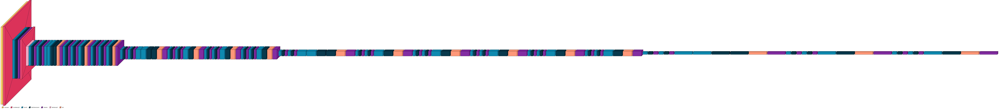

MobileNet **visualization**
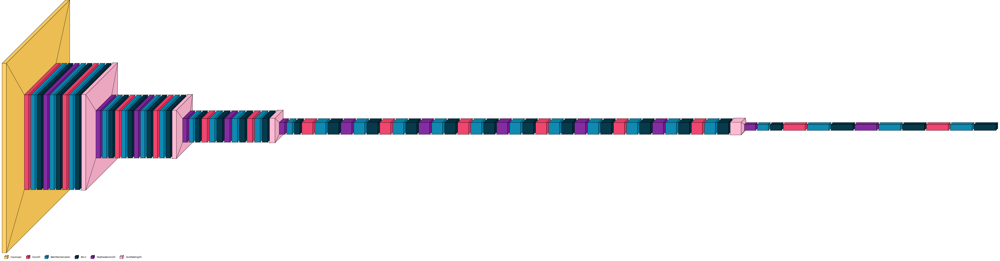

Load and print pretrained architectures:


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, MobileNet

# Load pre-trained models
resnet50 = ResNet50(weights='imagenet', input_shape=(224, 224, 3))
mobilenet = MobileNet(weights='imagenet', input_shape=(224, 224, 3))

# Print model summaries
print("\n--- ResNet50 Summary ---\n")
resnet50.summary()

print("\n--- MobileNet V1 Summary ---\n")
mobilenet.summary()


<a id="transfer-learning-init"></a>

## 14. 📊 Transfer Learning Comparison Initialization
⬆️ [Tabel of Contents](#contents_tabel)

The following code prints a header and initializes a list to store results from comparing ResNet50 and MobileNet models.


In [ ]:

print("=== Transfer Learning Comparison: ResNet50 vs MobileNet ===")

# Store results
results = []


=== Transfer Learning Comparison: ResNet50 vs MobileNet ===


<a id="running-transfer-learning-experiments"></a>

## 15. 🔁 Running Transfer Learning Experiments
⬆️ [Tabel of Contents](#contents_tabel)



=== Transfer Learning with ResNet50 - Strategy base ===


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/tf_flowers/incomplete.B2KH19_3.0.1/tf_flowers-train.tfrecord*...:   0%|   …

Dataset tf_flowers downloaded and prepared to /root/tensorflow_datasets/tf_flowers/3.0.1. Subsequent calls will reuse this data.
94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== ResNet50 Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 318

ResNet50 Layer Groups:
conv1: Layers 1-4 (Total: 4)
conv2: Layers 7-38 (Total: 32)
conv3: Layers 39-80 (Total: 42)
conv4: Layers 81-142 (Total: 62)
conv5: Layers 143-174 (Total: 32)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 33s 207ms/step - accuracy: 0.5490 - loss: 1.1896 - val_accuracy: 0.8530 - val_loss: 0.3864
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 115ms/step - accuracy: 0.8809 - loss: 0.3445 - val_accuracy: 0.8766 - val_loss: 0.3401
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 116ms/step - accuracy: 0.9079 - loss: 0.2918 - val_accuracy: 0.8893 - val_loss: 0.3131
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 9s 103ms/step - accuracy: 0.9135 - loss: 0.2530 - val_accuracy: 0.8947 - val_loss: 0.3027
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 105ms/step - accuracy: 0.9236 - loss: 0.2204 - val_accuracy: 0.8820 - val_loss: 0

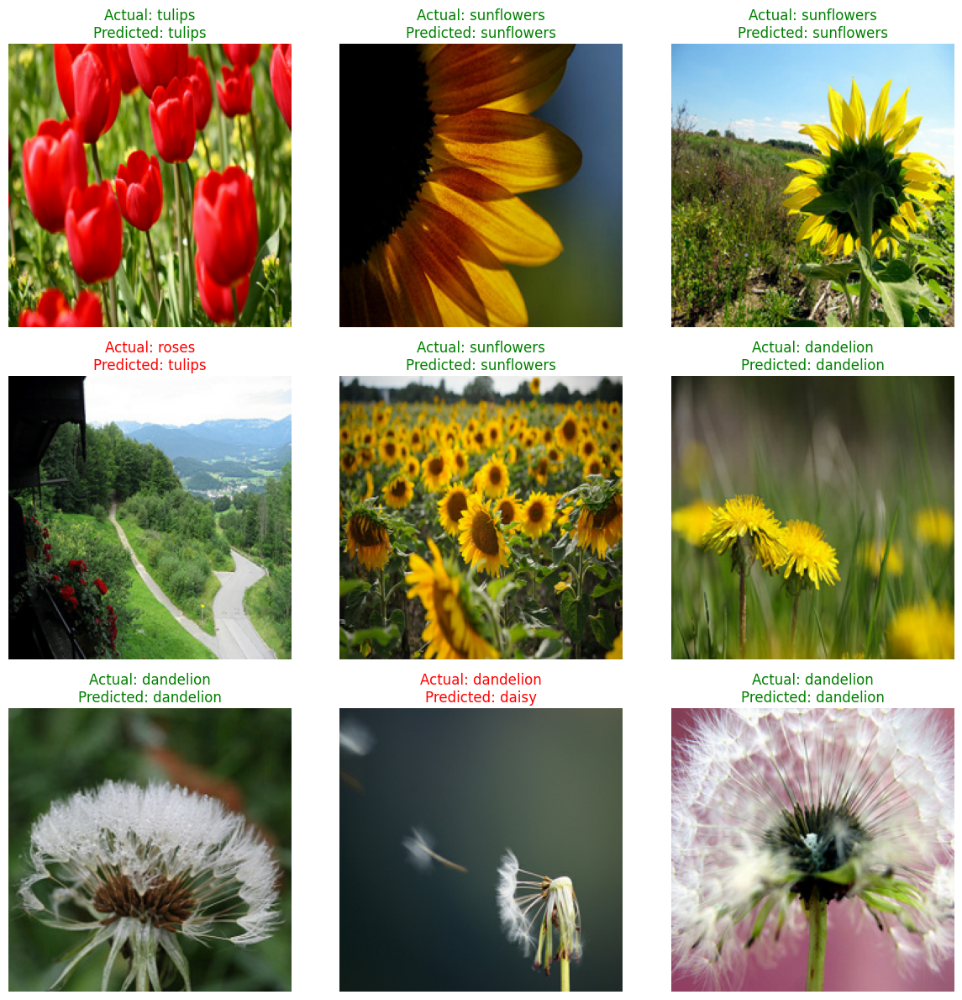

In [ ]:
# ResNet50 - Base Strategy
results.append(run_transfer_learning_experiment('resnet50','base', [5]))


=== Transfer Learning with MobileNet - Strategy base ===
17225924/17225924 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== MobileNet Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 135

MobileNet Layer Groups:
conv_base: Layers 1-1 (Total: 1)
conv_bn: Layers 2-2 (Total: 1)
conv_relu: Layers 3-3 (Total: 1)
conv_dw: Layers 4-82 (Total: 39)
conv_pw: Layers 7-85 (Total: 39)
conv_pad: Layers 10-73 (Total: 4)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 17s 111ms/step - accuracy: 0.4611 - loss: 1.4180 - val_accuracy: 0.8221 - val_loss: 0.5429
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 40ms/step - accuracy: 0.8073 - loss: 0.5321 - val_accuracy: 0.8512 - val_loss: 0.4391
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.8526 - loss: 0.4211 - val_accuracy: 0.8639 - val_loss: 0.3989
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 5s 40ms/step - accuracy: 0.8631 - loss: 0.3775 - val_accuracy: 0.8621 - val_loss: 0.3794
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.8740 - loss: 0.3405 - 

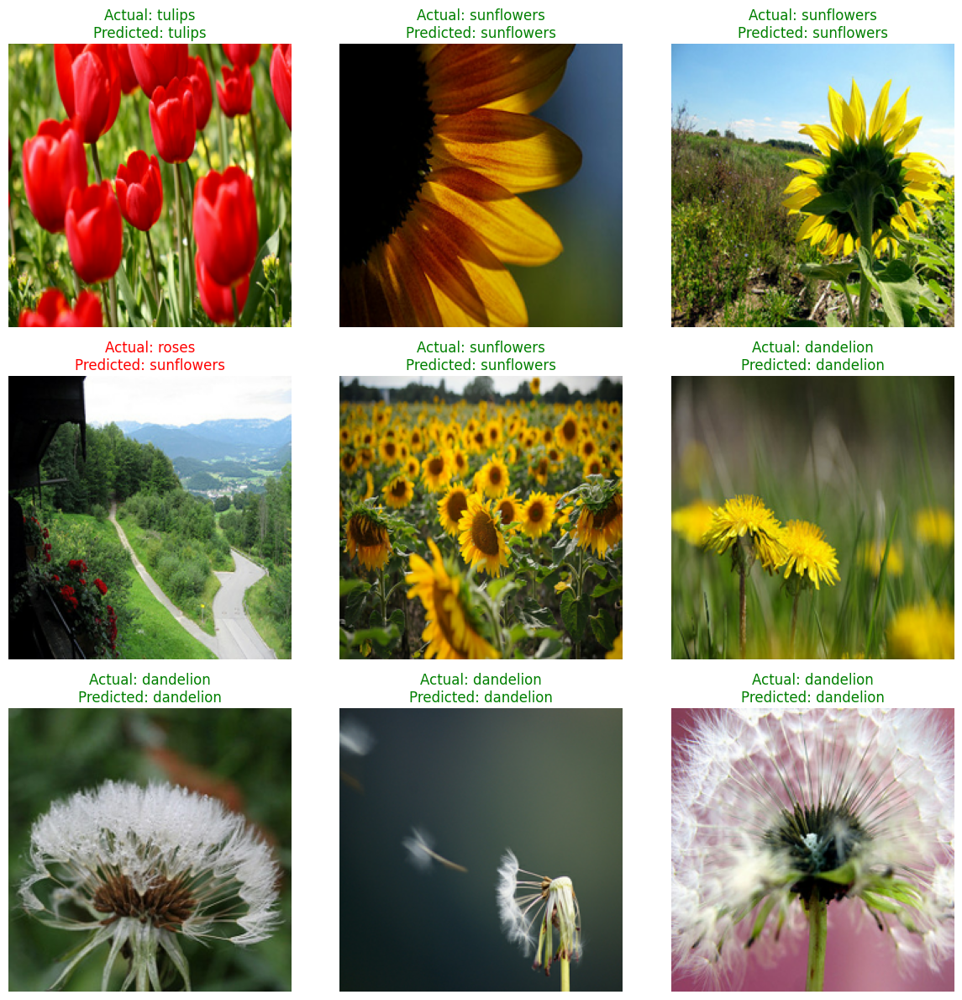

In [ ]:
# MobileNet - Base Strategy
results.append(run_transfer_learning_experiment('mobilenet','base', [5]))


=== Transfer Learning with ResNet50 - Strategy A ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== ResNet50 Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 318

ResNet50 Layer Groups:
conv1: Layers 1-4 (Total: 4)
conv2: Layers 7-38 (Total: 32)
conv3: Layers 39-80 (Total: 42)
conv4: Layers 81-142 (Total: 62)
conv5: Layers 143-174 (Total: 32)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 33s 214ms/step - accuracy: 0.5717 - loss: 1.1534 - val_accuracy: 0.8675 - val_loss: 0.3709
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 25s 106ms/step - accuracy: 0.8711 - loss: 0.3827 - val_accuracy: 0.8857 - val_loss: 0.3219
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 9s 108ms/step - accuracy: 0.8976 - loss: 0.3067 - val_accuracy: 0.8929 - val_loss: 0.3049
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 9s 109ms/step - accuracy: 0.9182 - loss: 0.2587 - val_accuracy: 0.8929 - val_loss: 0.2970
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 9s 109ms/step - accuracy: 0.9233 - loss: 0.2380 - val_accuracy: 0.8966 - val_loss: 0.2

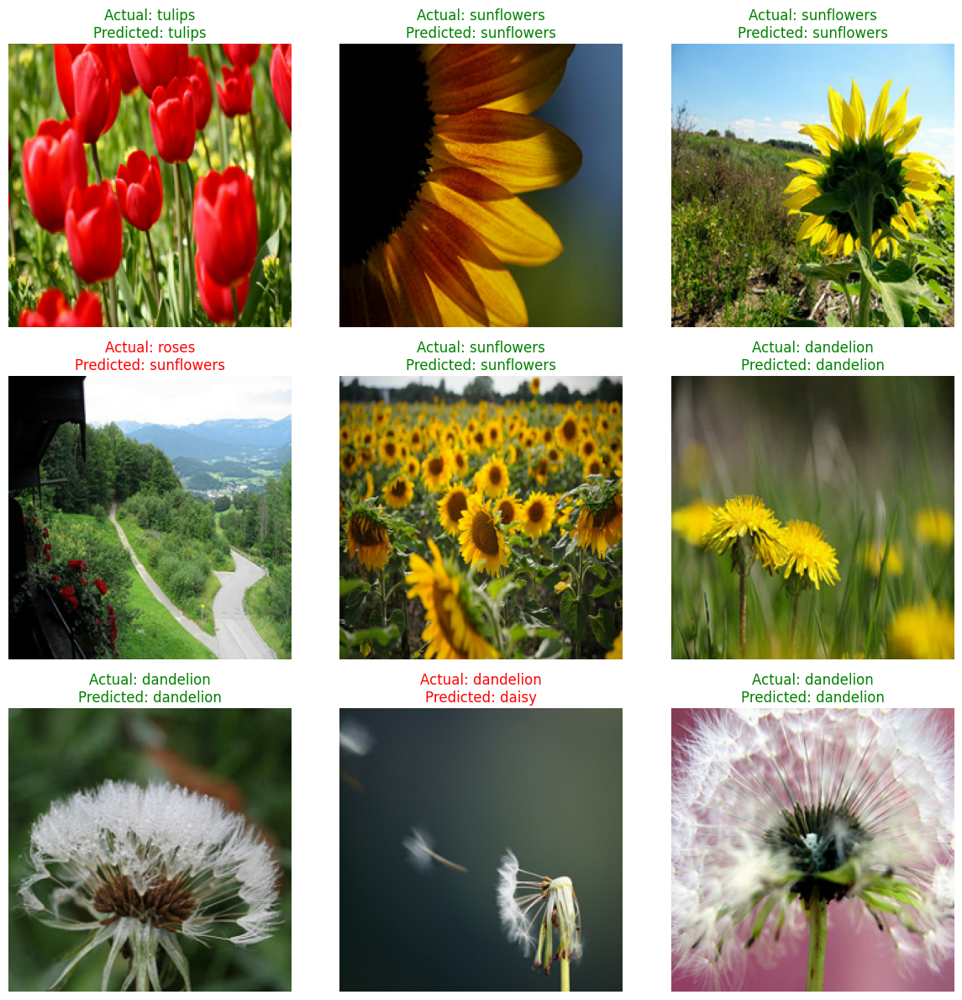

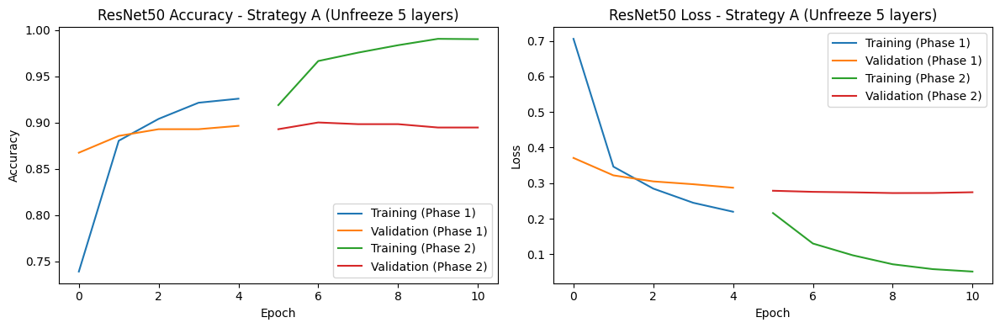

In [ ]:
# ResNet50 - Strategy A
results.append(run_transfer_learning_experiment('resnet50', 'A', [5]))


=== Transfer Learning with ResNet50 - Strategy A ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== ResNet50 Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 318

ResNet50 Layer Groups:
conv1: Layers 1-4 (Total: 4)
conv2: Layers 7-38 (Total: 32)
conv3: Layers 39-80 (Total: 42)
conv4: Layers 81-142 (Total: 62)
conv5: Layers 143-174 (Total: 32)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 27s 189ms/step - accuracy: 0.5781 - loss: 1.1123 - val_accuracy: 0.8621 - val_loss: 0.4020
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 9s 107ms/step - accuracy: 0.8834 - loss: 0.3362 - val_accuracy: 0.8730 - val_loss: 0.3518
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 9s 109ms/step - accuracy: 0.8994 - loss: 0.2941 - val_accuracy: 0.8966 - val_loss: 0.3237
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 109ms/step - accuracy: 0.9117 - loss: 0.2491 - val_accuracy: 0.8984 - val_loss: 0.3121
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 120ms/step - accuracy: 0.9260 - loss: 0.2231 - val_accuracy: 0.8929 - val_loss: 0.

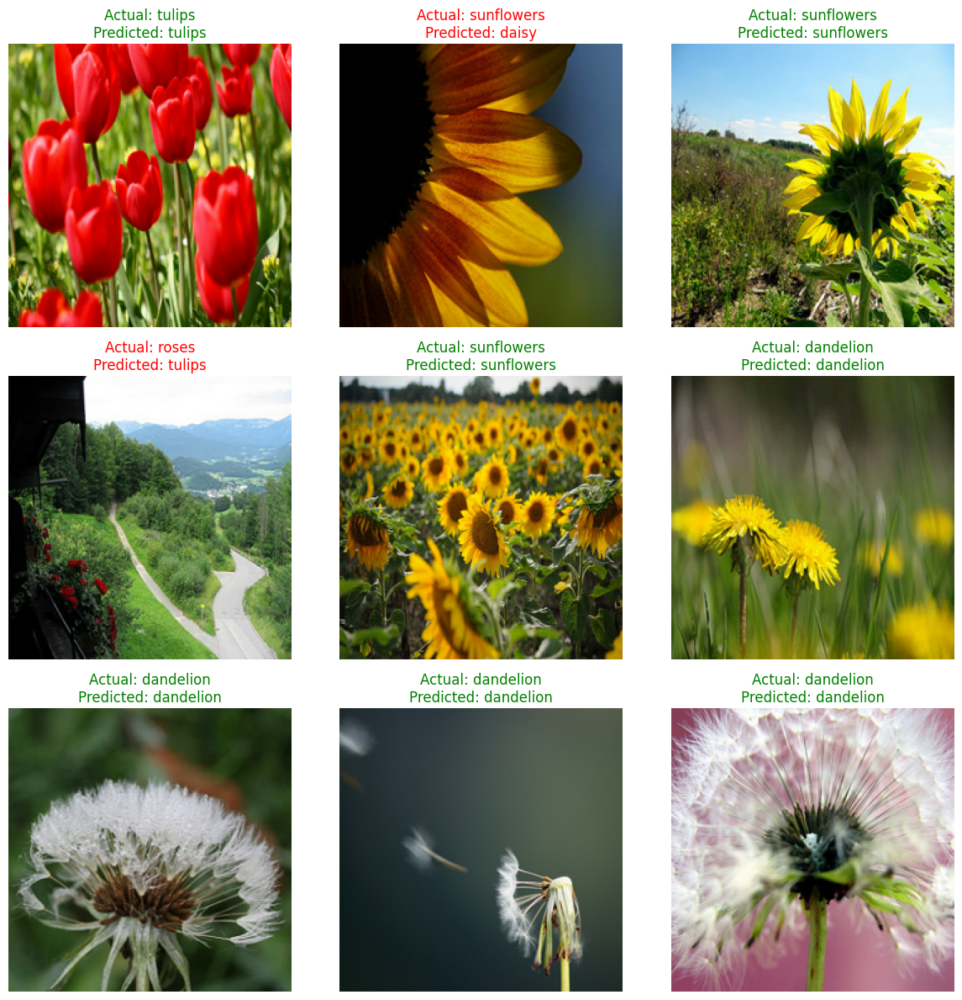

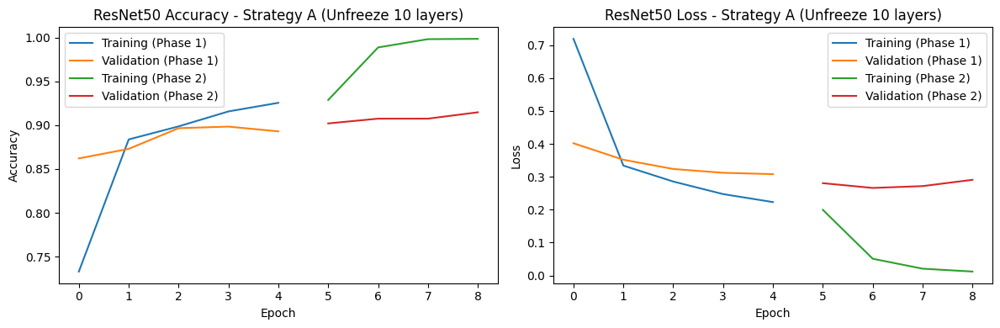

In [ ]:
# ResNet50 - Strategy A
results.append(run_transfer_learning_experiment('resnet50', 'A', [10]))


=== Transfer Learning with ResNet50 - Strategy A ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== ResNet50 Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 318

ResNet50 Layer Groups:
conv1: Layers 1-4 (Total: 4)
conv2: Layers 7-38 (Total: 32)
conv3: Layers 39-80 (Total: 42)
conv4: Layers 81-142 (Total: 62)
conv5: Layers 143-174 (Total: 32)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 35s 254ms/step - accuracy: 0.5636 - loss: 1.1429 - val_accuracy: 0.8584 - val_loss: 0.3897
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 26s 121ms/step - accuracy: 0.8587 - loss: 0.3787 - val_accuracy: 0.8766 - val_loss: 0.3343
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 122ms/step - accuracy: 0.8742 - loss: 0.3285 - val_accuracy: 0.8857 - val_loss: 0.3183
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 20s 118ms/step - accuracy: 0.9022 - loss: 0.2797 - val_accuracy: 0.8911 - val_loss: 0.3019
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 120ms/step - accuracy: 0.9128 - loss: 0.2388 - val_accuracy: 0.8857 - val_loss: 

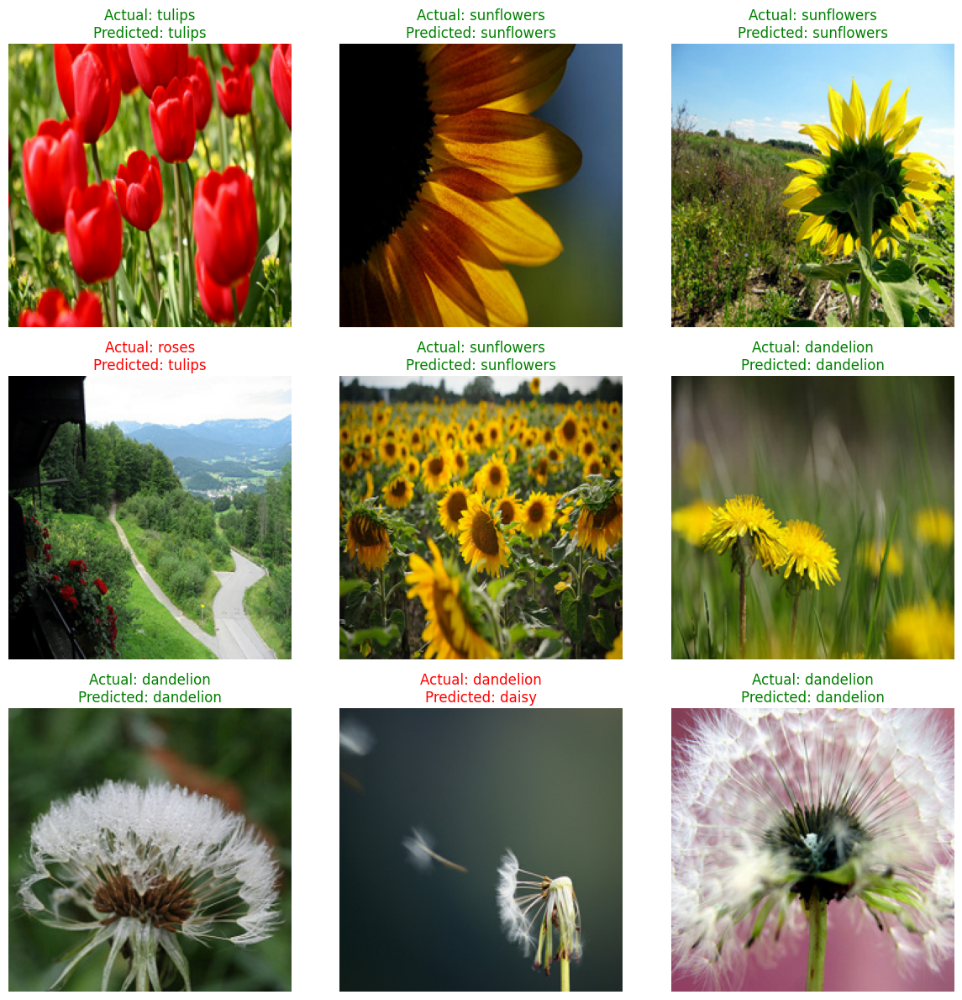

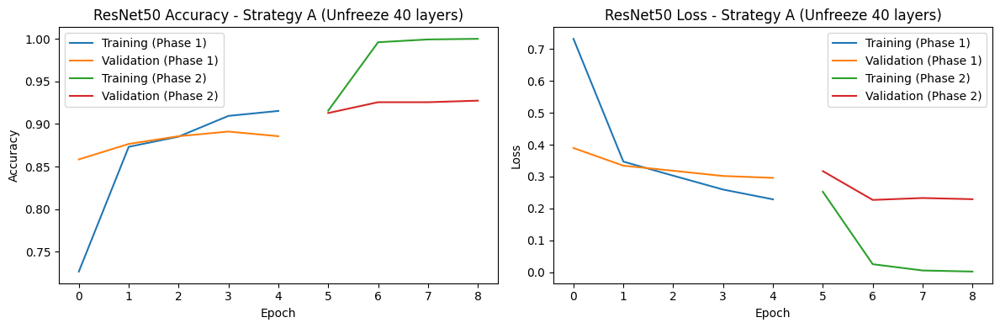

In [ ]:
# ResNet50 - Strategy A
results.append(run_transfer_learning_experiment('resnet50', 'A', [40]))


=== Transfer Learning with ResNet50 - Strategy B ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== ResNet50 Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 318

ResNet50 Layer Groups:
conv1: Layers 1-4 (Total: 4)
conv2: Layers 7-38 (Total: 32)
conv3: Layers 39-80 (Total: 42)
conv4: Layers 81-142 (Total: 62)
conv5: Layers 143-174 (Total: 32)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 28s 200ms/step - accuracy: 0.5686 - loss: 1.1652 - val_accuracy: 0.8530 - val_loss: 0.4262
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 31s 121ms/step - accuracy: 0.8768 - loss: 0.3651 - val_accuracy: 0.8657 - val_loss: 0.3690
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 19s 108ms/step - accuracy: 0.9031 - loss: 0.3014 - val_accuracy: 0.8802 - val_loss: 0.3388
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 109ms/step - accuracy: 0.9015 - loss: 0.2612 - val_accuracy: 0.8802 - val_loss: 0.3294
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 109ms/step - accuracy: 0.9139 - loss: 0.2342 - val_accuracy: 0.8911 - val_loss: 

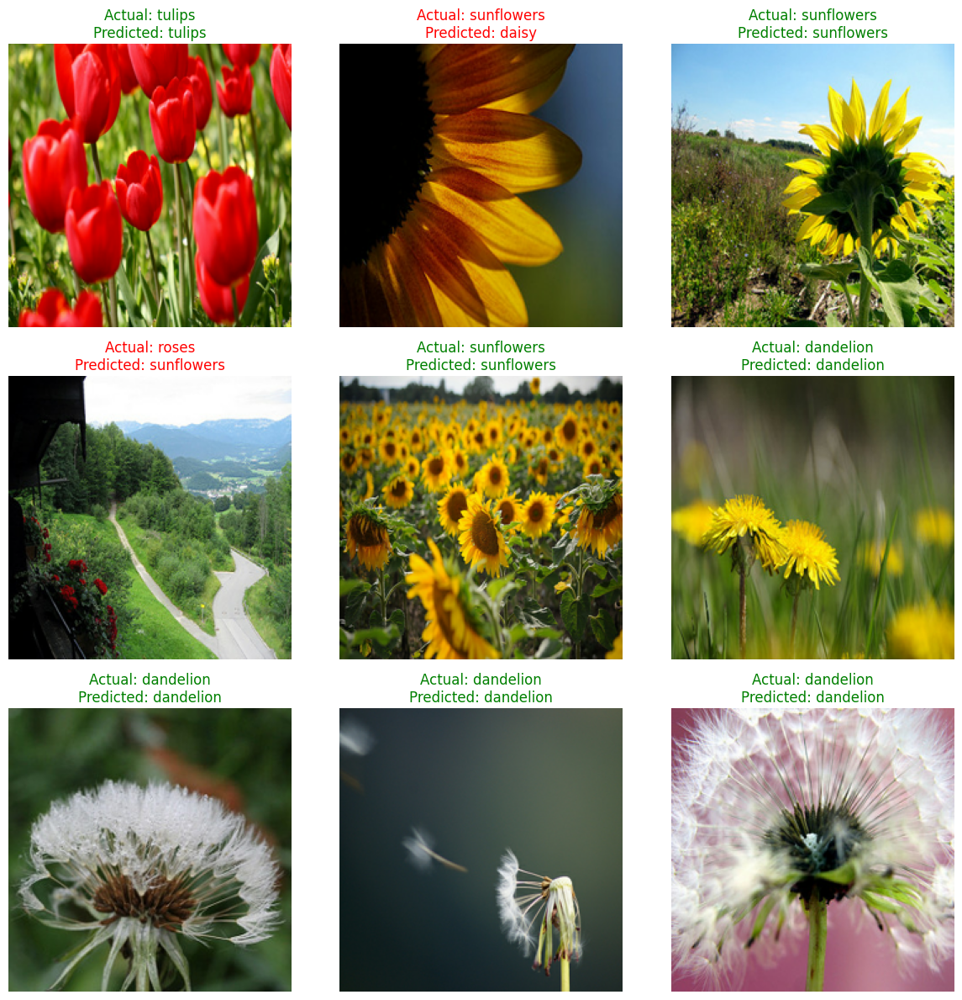

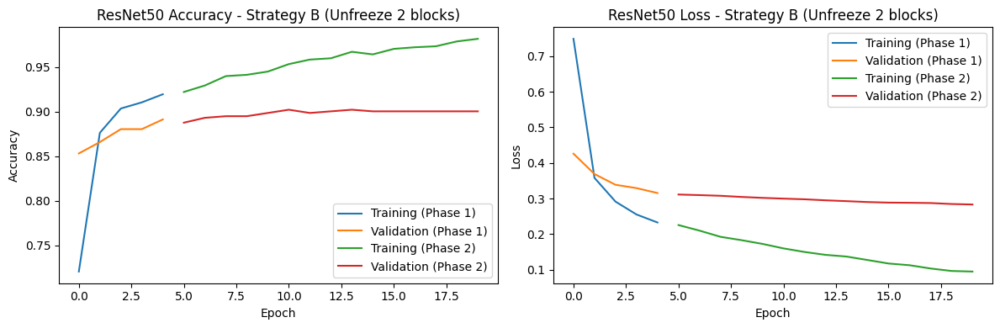

In [ ]:
# ResNet50 - Strategy B
results.append(run_transfer_learning_experiment('resnet50', 'B', 2))


=== Transfer Learning with ResNet50 - Strategy B ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== ResNet50 Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 318

ResNet50 Layer Groups:
conv1: Layers 1-4 (Total: 4)
conv2: Layers 7-38 (Total: 32)
conv3: Layers 39-80 (Total: 42)
conv4: Layers 81-142 (Total: 62)
conv5: Layers 143-174 (Total: 32)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 33s 252ms/step - accuracy: 0.5522 - loss: 1.2085 - val_accuracy: 0.8711 - val_loss: 0.3899
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 120ms/step - accuracy: 0.8693 - loss: 0.3584 - val_accuracy: 0.8929 - val_loss: 0.3364
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 20s 120ms/step - accuracy: 0.8880 - loss: 0.2975 - val_accuracy: 0.8947 - val_loss: 0.3206
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 19s 106ms/step - accuracy: 0.9037 - loss: 0.2744 - val_accuracy: 0.8893 - val_loss: 0.3067
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 9s 108ms/step - accuracy: 0.9172 - loss: 0.2361 - val_accuracy: 0.8929 - val_loss: 0

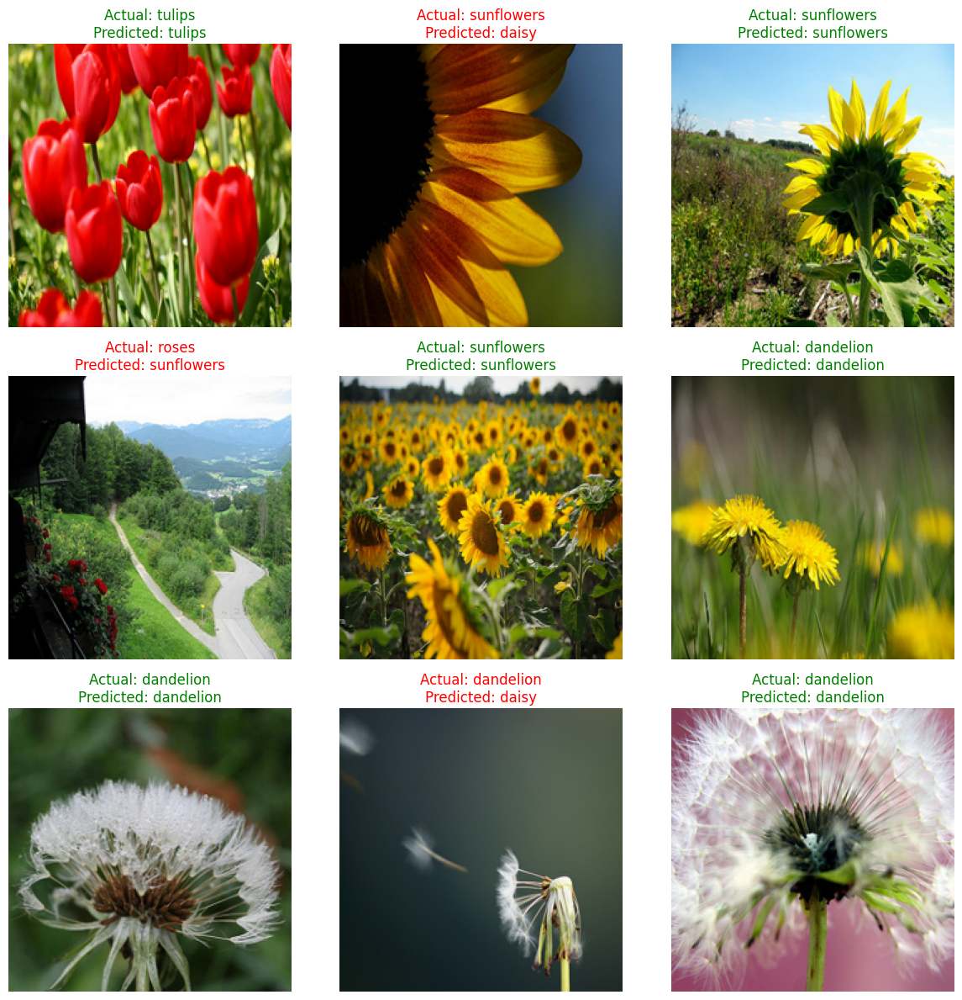

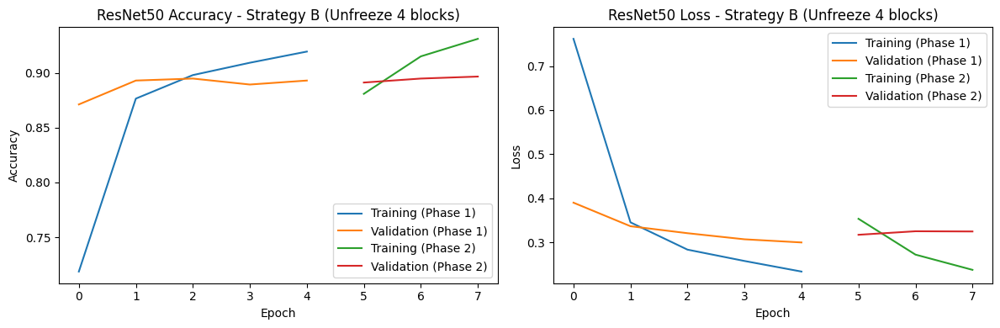

In [ ]:
# ResNet50 - Strategy B
results.append(run_transfer_learning_experiment('resnet50', 'B', 4))


=== Transfer Learning with ResNet50 - Strategy B ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== ResNet50 Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 318

ResNet50 Layer Groups:
conv1: Layers 1-4 (Total: 4)
conv2: Layers 7-38 (Total: 32)
conv3: Layers 39-80 (Total: 42)
conv4: Layers 81-142 (Total: 62)
conv5: Layers 143-174 (Total: 32)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 28s 196ms/step - accuracy: 0.5467 - loss: 1.1576 - val_accuracy: 0.8457 - val_loss: 0.4171
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 29s 108ms/step - accuracy: 0.8554 - loss: 0.3850 - val_accuracy: 0.8657 - val_loss: 0.3568
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 10s 120ms/step - accuracy: 0.8908 - loss: 0.3064 - val_accuracy: 0.8857 - val_loss: 0.3353
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 20s 120ms/step - accuracy: 0.8979 - loss: 0.2774 - val_accuracy: 0.8911 - val_loss: 0.3197
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 20s 119ms/step - accuracy: 0.9247 - loss: 0.2230 - val_accuracy: 0.8947 - val_loss: 

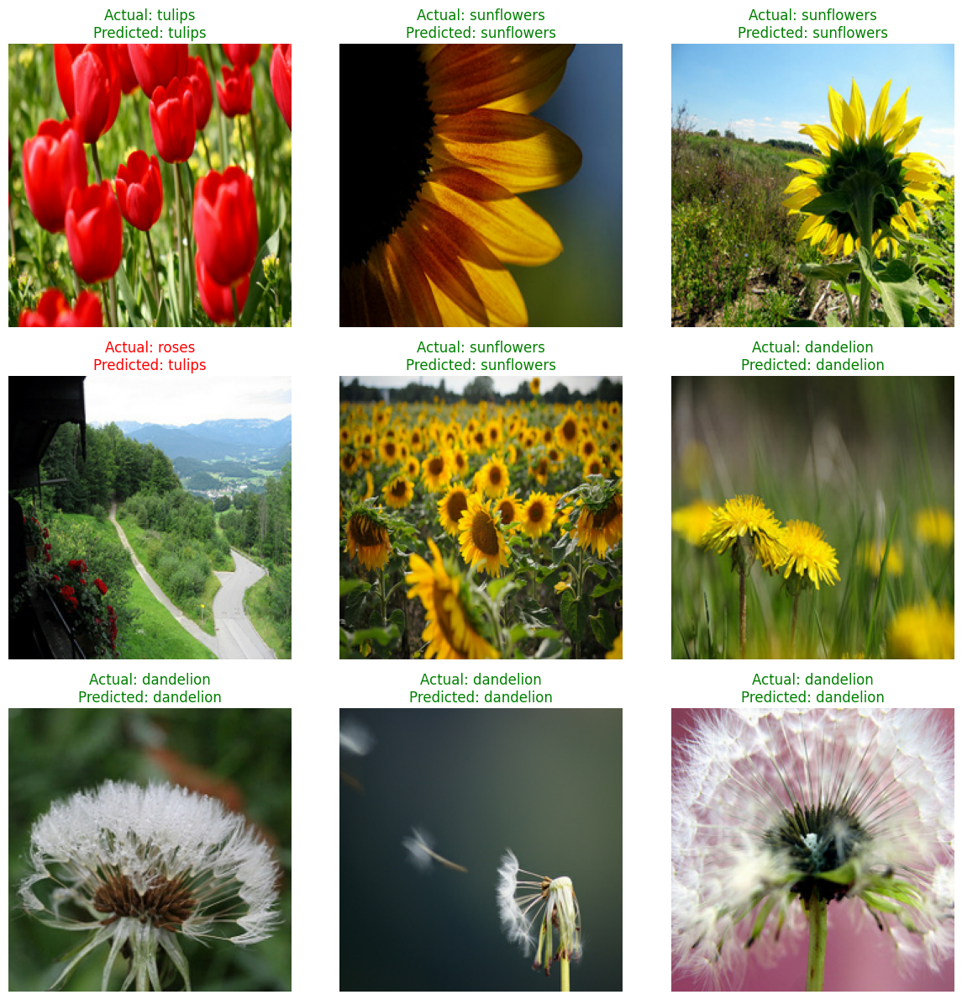

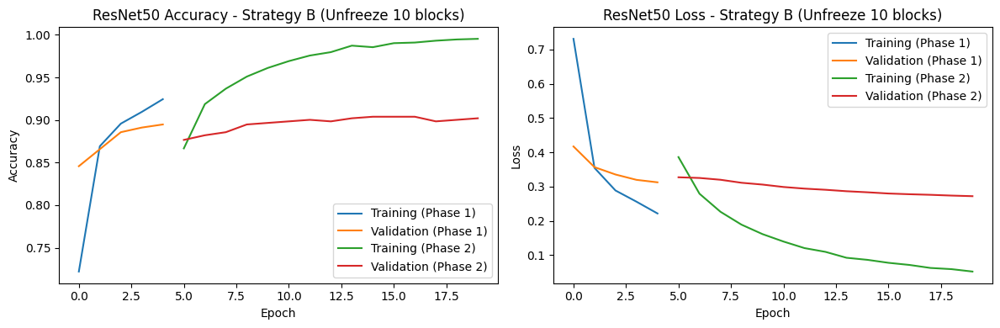

In [ ]:
# ResNet50 - Strategy B
results.append(run_transfer_learning_experiment('resnet50', 'B', 10))


=== Transfer Learning with MobileNet - Strategy A ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== MobileNet Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 135

MobileNet Layer Groups:
conv_base: Layers 1-1 (Total: 1)
conv_bn: Layers 2-2 (Total: 1)
conv_relu: Layers 3-3 (Total: 1)
conv_dw: Layers 4-82 (Total: 39)
conv_pw: Layers 7-85 (Total: 39)
conv_pad: Layers 10-73 (Total: 4)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 18s 111ms/step - accuracy: 0.4528 - loss: 1.4385 - val_accuracy: 0.8203 - val_loss: 0.5327
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.8084 - loss: 0.5320 - val_accuracy: 0.8494 - val_loss: 0.4386
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.8507 - loss: 0.4087 - val_accuracy: 0.8621 - val_loss: 0.4016
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 40ms/step - accuracy: 0.8651 - loss: 0.3607 - val_accuracy: 0.8711 - val_loss: 0.3866
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 5s 39ms/step - accuracy: 0.8800 - loss: 0.3272 - v

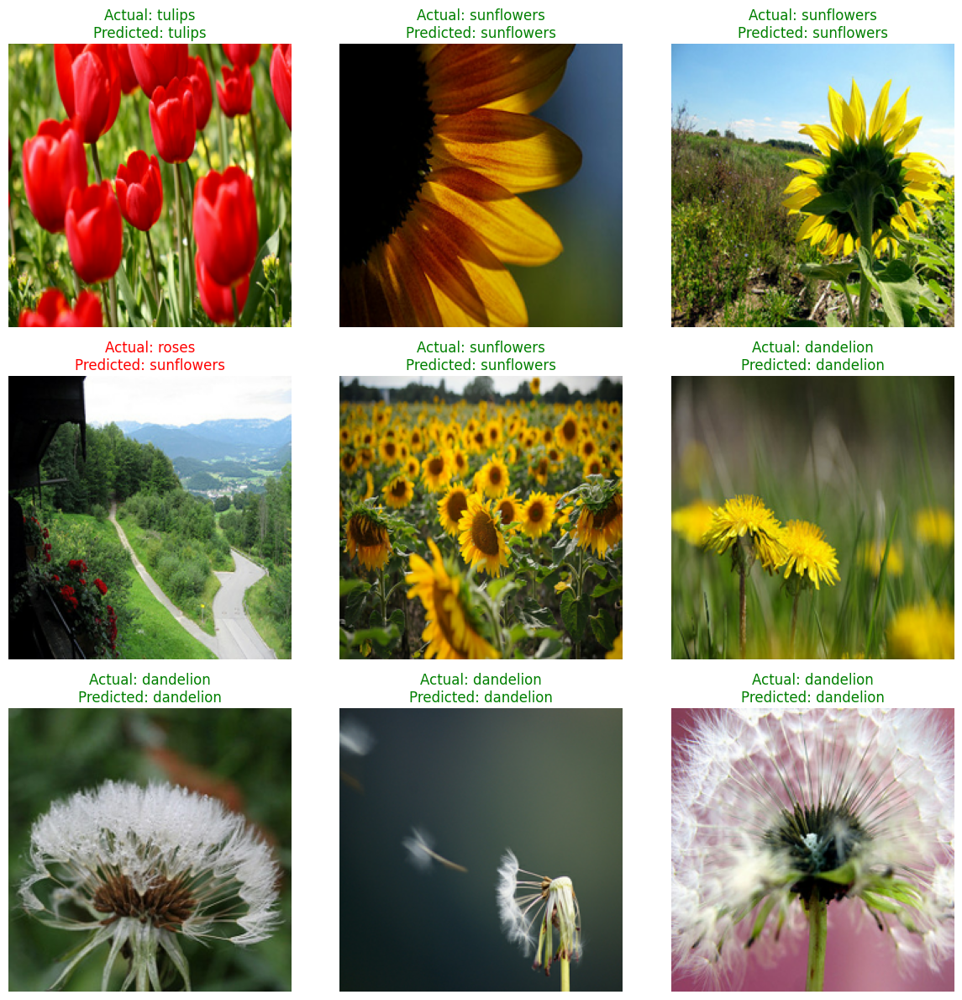

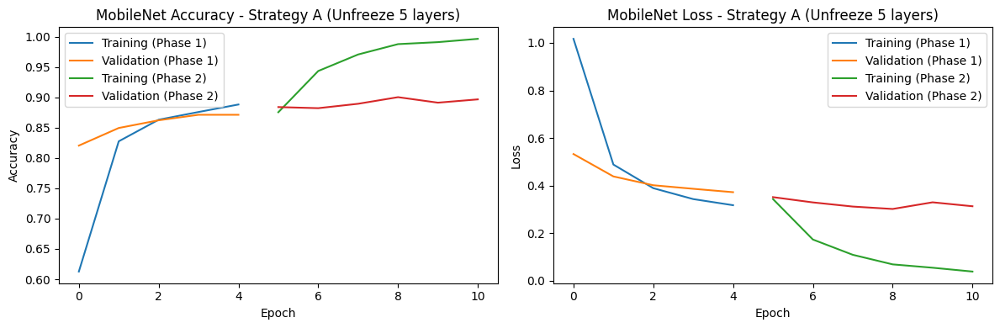

In [ ]:
# MobileNet - Strategy A
results.append(run_transfer_learning_experiment('mobilenet', 'A', [5]))


=== Transfer Learning with MobileNet - Strategy A ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== MobileNet Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 135

MobileNet Layer Groups:
conv_base: Layers 1-1 (Total: 1)
conv_bn: Layers 2-2 (Total: 1)
conv_relu: Layers 3-3 (Total: 1)
conv_dw: Layers 4-82 (Total: 39)
conv_pw: Layers 7-85 (Total: 39)
conv_pad: Layers 10-73 (Total: 4)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 15s 118ms/step - accuracy: 0.4107 - loss: 1.5356 - val_accuracy: 0.8167 - val_loss: 0.5239
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.8122 - loss: 0.5210 - val_accuracy: 0.8494 - val_loss: 0.4215
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 40ms/step - accuracy: 0.8647 - loss: 0.4024 - val_accuracy: 0.8584 - val_loss: 0.3892
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 5s 40ms/step - accuracy: 0.8737 - loss: 0.3704 - val_accuracy: 0.8766 - val_loss: 0.3691
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.8792 - loss: 0.3343 - v

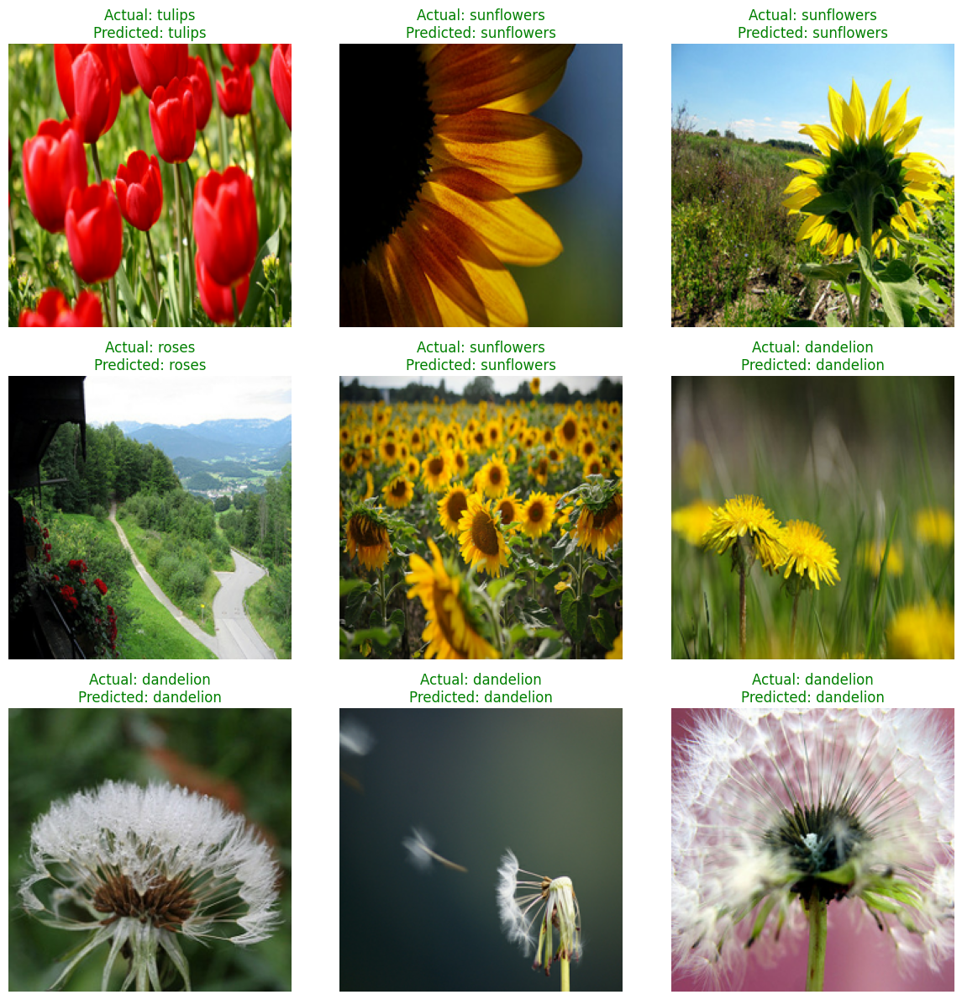

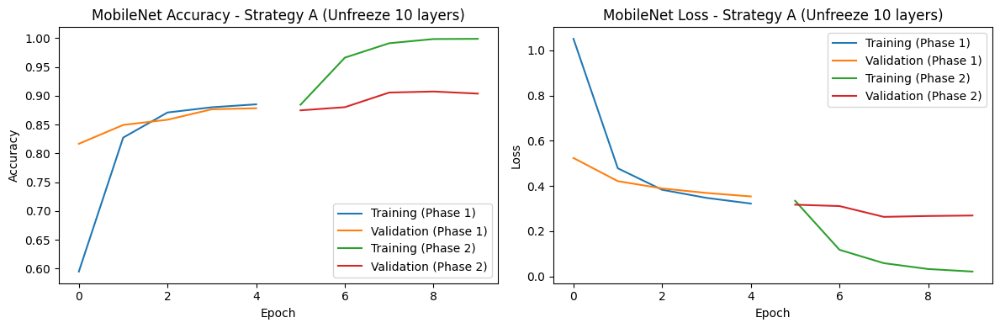

In [ ]:
# MobileNet - Strategy A
results.append(run_transfer_learning_experiment('mobilenet', 'A', [10]))


=== Transfer Learning with MobileNet - Strategy A ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== MobileNet Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 135

MobileNet Layer Groups:
conv_base: Layers 1-1 (Total: 1)
conv_bn: Layers 2-2 (Total: 1)
conv_relu: Layers 3-3 (Total: 1)
conv_dw: Layers 4-82 (Total: 39)
conv_pw: Layers 7-85 (Total: 39)
conv_pad: Layers 10-73 (Total: 4)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 14s 112ms/step - accuracy: 0.4601 - loss: 1.4346 - val_accuracy: 0.8113 - val_loss: 0.5386
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 13s 42ms/step - accuracy: 0.8126 - loss: 0.5220 - val_accuracy: 0.8494 - val_loss: 0.4391
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.8423 - loss: 0.4359 - val_accuracy: 0.8548 - val_loss: 0.4042
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.8771 - loss: 0.3557 - val_accuracy: 0.8639 - val_loss: 0.3756
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 5s 40ms/step - accuracy: 0.8851 - loss: 0.3365 - 

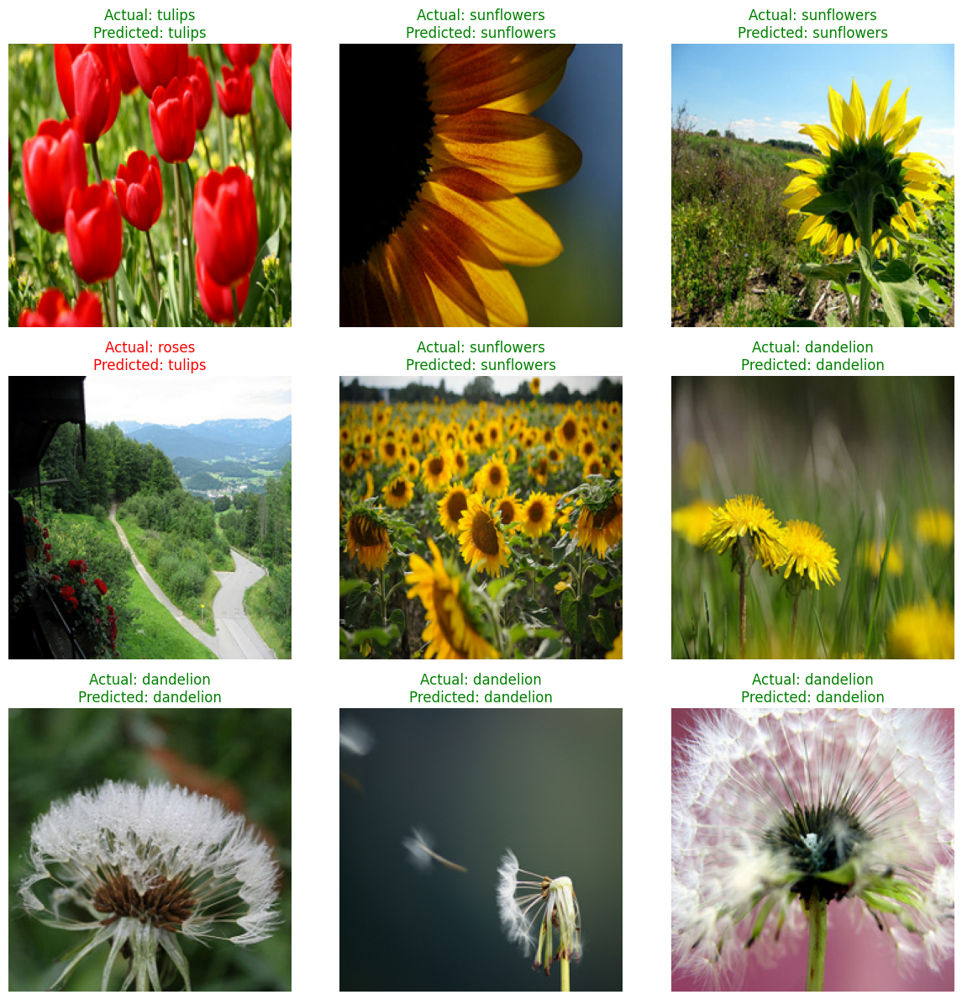

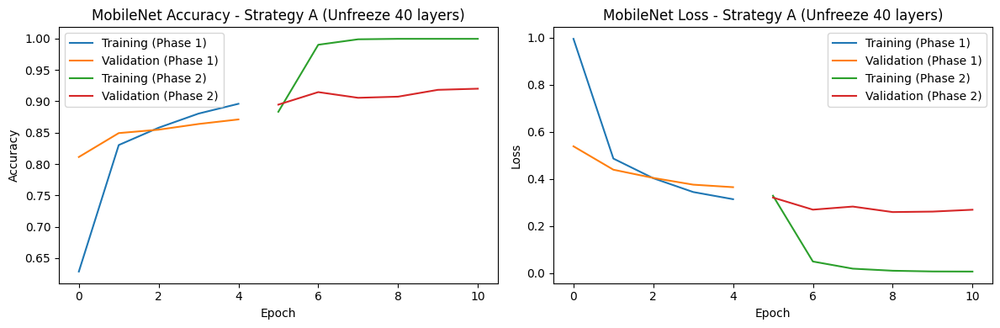

In [ ]:
# MobileNet - Strategy A
results.append(run_transfer_learning_experiment('mobilenet', 'A', [40]))


=== Transfer Learning with MobileNet - Strategy B ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== MobileNet Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 135

MobileNet Layer Groups:
conv_base: Layers 1-1 (Total: 1)
conv_bn: Layers 2-2 (Total: 1)
conv_relu: Layers 3-3 (Total: 1)
conv_dw: Layers 4-82 (Total: 39)
conv_pw: Layers 7-85 (Total: 39)
conv_pad: Layers 10-73 (Total: 4)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 13s 84ms/step - accuracy: 0.4584 - loss: 1.4132 - val_accuracy: 0.8131 - val_loss: 0.5298
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.8327 - loss: 0.5012 - val_accuracy: 0.8566 - val_loss: 0.4349
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 5s 39ms/step - accuracy: 0.8565 - loss: 0.4151 - val_accuracy: 0.8657 - val_loss: 0.4012
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 5s 39ms/step - accuracy: 0.8664 - loss: 0.3581 - val_accuracy: 0.8693 - val_loss: 0.3793
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 5s 39ms/step - accuracy: 0.8849 - loss: 0.3293 - va

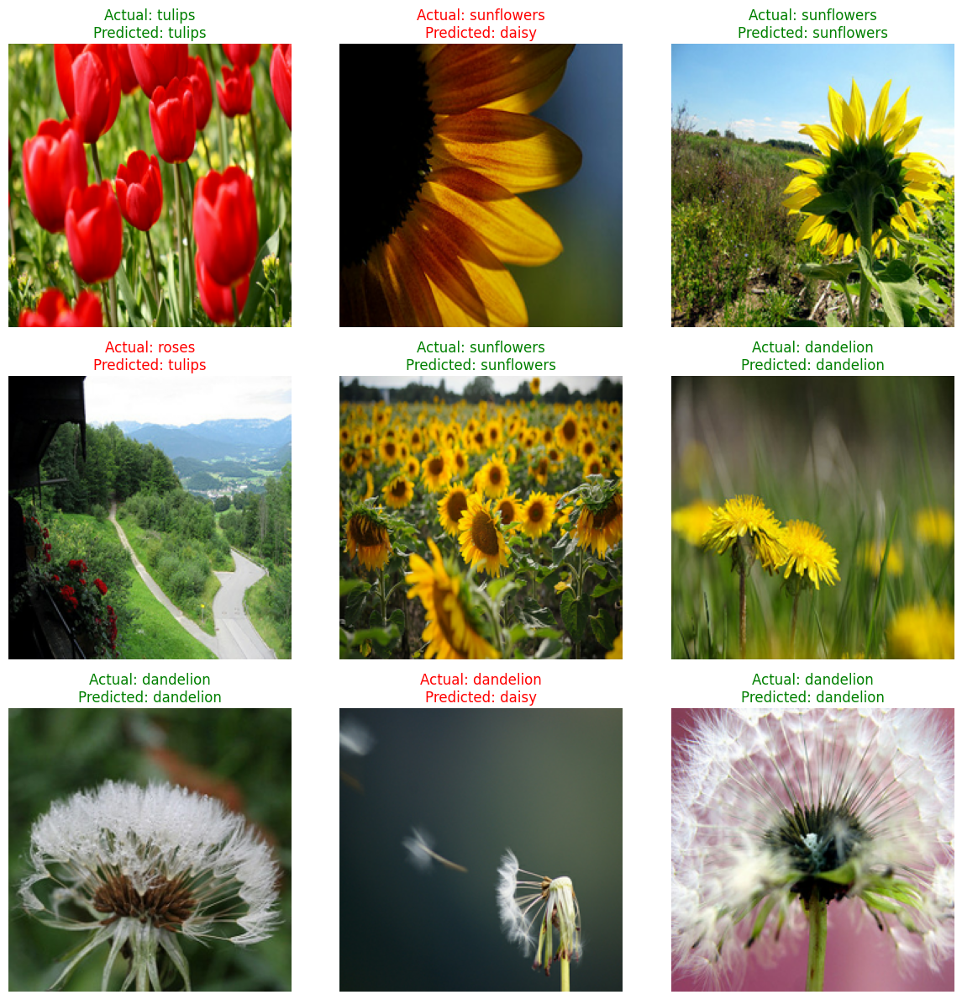

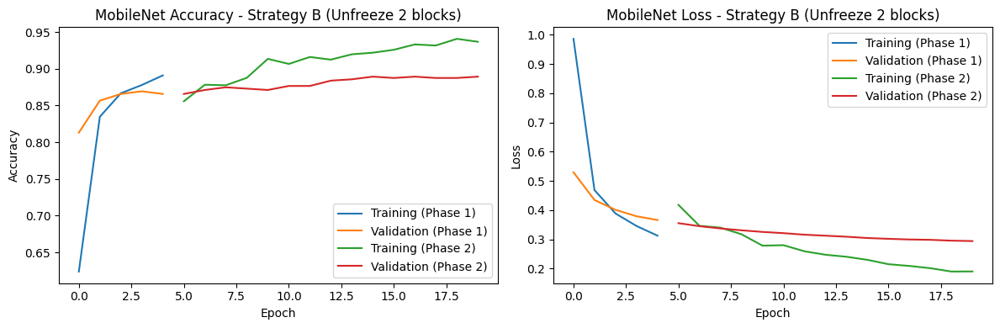

In [ ]:
# MobileNet - Strategy B
results.append(run_transfer_learning_experiment('mobilenet', 'B', 2))


=== Transfer Learning with MobileNet - Strategy B ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== MobileNet Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 135

MobileNet Layer Groups:
conv_base: Layers 1-1 (Total: 1)
conv_bn: Layers 2-2 (Total: 1)
conv_relu: Layers 3-3 (Total: 1)
conv_dw: Layers 4-82 (Total: 39)
conv_pw: Layers 7-85 (Total: 39)
conv_pad: Layers 10-73 (Total: 4)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 14s 84ms/step - accuracy: 0.4760 - loss: 1.4251 - val_accuracy: 0.8185 - val_loss: 0.5544
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 5s 41ms/step - accuracy: 0.8096 - loss: 0.5231 - val_accuracy: 0.8566 - val_loss: 0.4564
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 40ms/step - accuracy: 0.8550 - loss: 0.4169 - val_accuracy: 0.8603 - val_loss: 0.4163
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 5s 42ms/step - accuracy: 0.8730 - loss: 0.3764 - val_accuracy: 0.8711 - val_loss: 0.3927
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 40ms/step - accuracy: 0.8868 - loss: 0.3232 - va

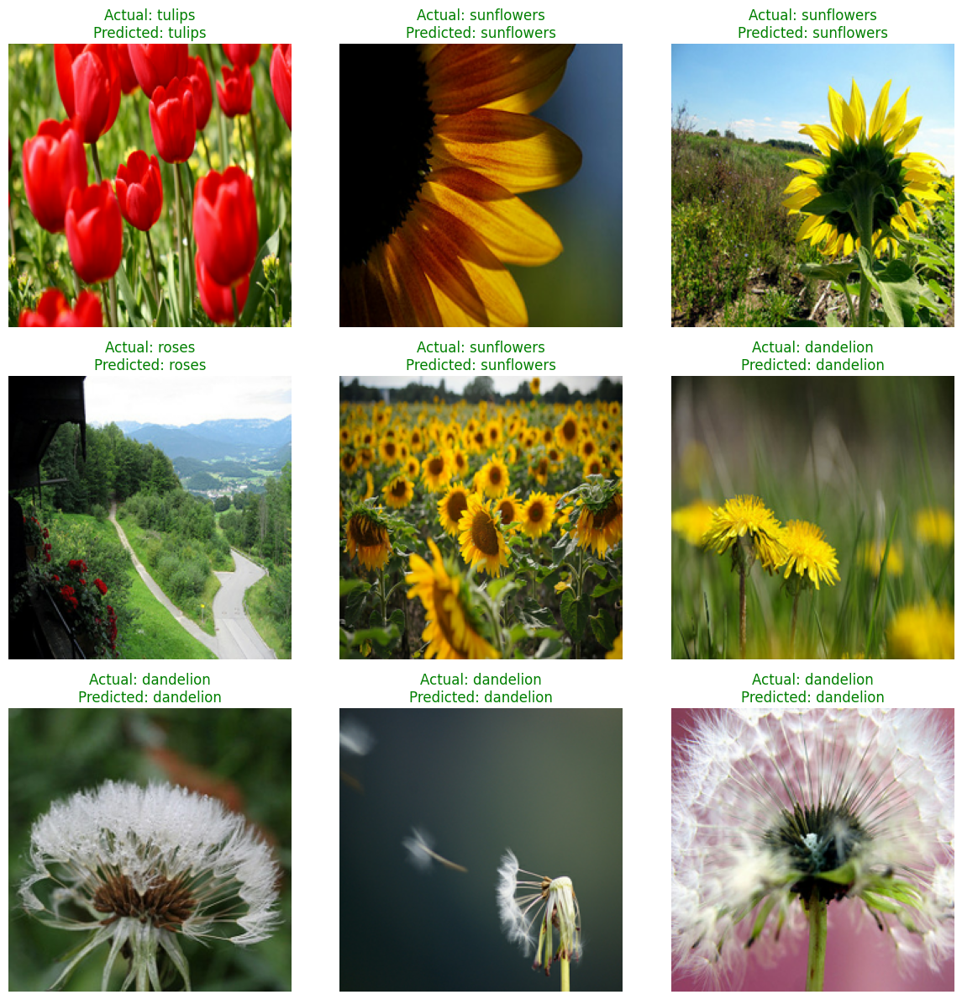

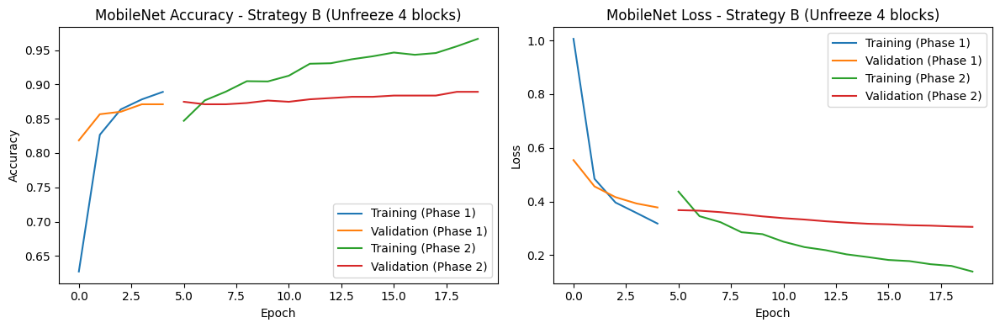

In [ ]:
# MobileNet - Strategy B
results.append(run_transfer_learning_experiment('mobilenet', 'B', 4))


=== Transfer Learning with MobileNet - Strategy B ===


/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


=== MobileNet Model Structure ===
Total layers in model: 5
Base model trainable: False
Trainable weights: 2
Non-trainable weights: 135

MobileNet Layer Groups:
conv_base: Layers 1-1 (Total: 1)
conv_bn: Layers 2-2 (Total: 1)
conv_relu: Layers 3-3 (Total: 1)
conv_dw: Layers 4-82 (Total: 39)
conv_pw: Layers 7-85 (Total: 39)
conv_pad: Layers 10-73 (Total: 4)

--- Phase 1: Training with frozen base model ---
Epoch 1/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 15s 113ms/step - accuracy: 0.4212 - loss: 1.5047 - val_accuracy: 0.8022 - val_loss: 0.5498
Epoch 2/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 40ms/step - accuracy: 0.8059 - loss: 0.5347 - val_accuracy: 0.8494 - val_loss: 0.4469
Epoch 3/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.8428 - loss: 0.4289 - val_accuracy: 0.8584 - val_loss: 0.4046
Epoch 4/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.8646 - loss: 0.3839 - val_accuracy: 0.8566 - val_loss: 0.3822
Epoch 5/5
86/86 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.8745 - loss: 0.3522 - v

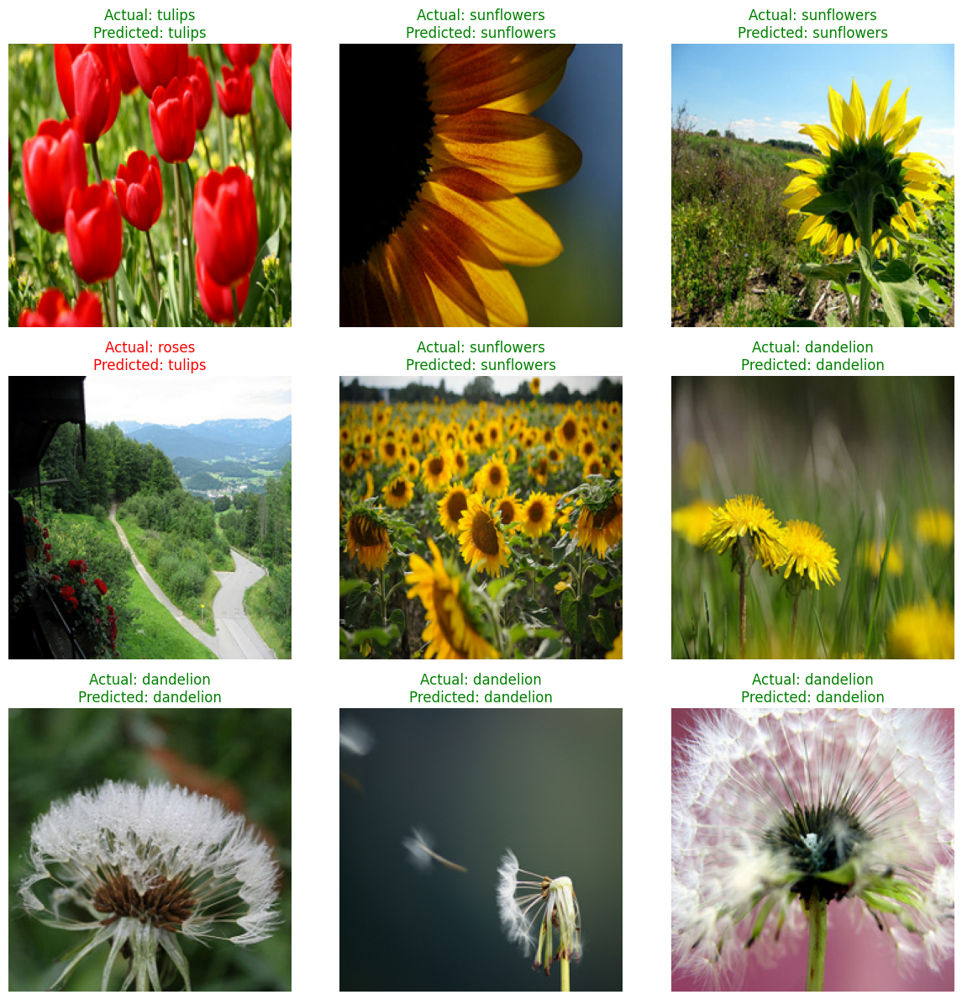

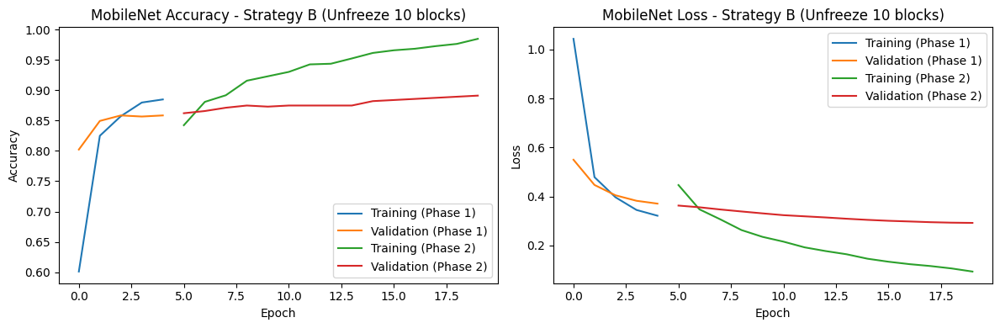

In [ ]:
# MobileNet - Strategy B
results.append(run_transfer_learning_experiment('mobilenet', 'B', 10))

<a id="summary-of-results"></a>

## 16. 📊 Summary of Results

⬆️ [Tabel of Contents](#contents_tabel)

After running all experiments, a summary is printed out detailing performance metrics for each configuration.

In [ ]:
# Flatten the list of results before printing
print("\n=== Results Summary ===")
for result_group in results:
    for res in result_group:  # This is to access each dictionary inside the list
        print(f"\n{res['model']} - {res['strategy']}:")
        print(f"  - Test Accuracy: {res['accuracy']:.2%}")
        print(f"  - Inference Time: {res['inference_time']*1000:.2f} ms per image")
        print(f"  - Total Parameters: {res['params']:,}")
        print(f"  - Trainable Parameters: {res['trainable_params']:,}")
print("\n=== Transfer Learning Workflow Complete ===")


=== Results Summary ===

MobileNet - Strategy A (Unfreeze 5 layers):
  - Test Accuracy: 88.56%
  - Inference Time: 48.95 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 5,125

MobileNet - Strategy A (Unfreeze 10 layers):
  - Test Accuracy: 88.28%
  - Inference Time: 37.09 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 5,125

MobileNet - Strategy A (Unfreeze 40 layers):
  - Test Accuracy: 88.01%
  - Inference Time: 53.15 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 5,125

MobileNet - Strategy B (Unfreeze 2 blocks):
  - Test Accuracy: 91.83%
  - Inference Time: 37.15 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 1,598,981

MobileNet - Strategy B (Unfreeze 4 blocks):
  - Test Accuracy: 92.37%
  - Inference Time: 37.91 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 2,136,581

MobileNet - Strategy B (Unfreeze 10 blocks):
  - Test Accuracy: 91.28%
  - Inference Time: 53.

```python
[[{'model': 'ResNet50',
   'strategy': 'BaseModel',
   'unfreeze_layers': 'None',
   'accuracy': 0.9209809303283691,
   'loss': 0.2579611539840698,
   'inference_time': 0.20631598711013793,
   'params': 23597957,
   'trainable_params': np.int64(10245)}],
 [{'model': 'MobileNet',
   'strategy': 'BaseModel',
   'unfreeze_layers': 'None',
   'accuracy': 0.9019073843955994,
   'loss': 0.3258683383464813,
   'inference_time': 0.05252807140350342,
   'params': 3233989,
   'trainable_params': np.int64(5125)}]]
```

```python
[[{'model': 'ResNet50',
   'strategy': 'Strategy A (Unfreeze 5 layers)',
   'unfreeze_layers': 5,
   'accuracy': 0.9209809303283691,
   'loss': 0.2656254470348358,
   'inference_time': 0.20629422664642333,
   'params': 23597957,
   'trainable_params': np.int64(10245)}],
 [{'model': 'ResNet50',
   'strategy': 'Strategy A (Unfreeze 10 layers)',
   'unfreeze_layers': 10,
   'accuracy': 0.9155313372612,
   'loss': 0.2676429748535156,
   'inference_time': 0.10478698968887329,
   'params': 23597957,
   'trainable_params': np.int64(10245)}],
 [{'model': 'ResNet50',
   'strategy': 'Strategy A (Unfreeze 40 layers)',
   'unfreeze_layers': 40,
   'accuracy': 0.9209809303283691,
   'loss': 0.2603384256362915,
   'inference_time': 0.1046288275718689,
   'params': 23597957,
   'trainable_params': np.int64(10245)}],
 [{'model': 'ResNet50',
   'strategy': 'Strategy B (Unfreeze 2 blocks)',
   'unfreeze_blocks': 2,
   'accuracy': 0.9182561039924622,
   'loss': 0.2026699036359787,
   'inference_time': 0.0870291805267334,
   'params': 23597957,
   'trainable_params': np.int64(8941573)}],
 [{'model': 'ResNet50',
   'strategy': 'Strategy B (Unfreeze 4 blocks)',
   'unfreeze_blocks': 4,
   'accuracy': 0.9100817441940308,
   'loss': 0.2624726891517639,
   'inference_time': 0.09307129144668579,
   'params': 23597957,
   'trainable_params': np.int64(16104965)}],
 [{'model': 'ResNet50',
   'strategy': 'Strategy B (Unfreeze 10 blocks)',
   'unfreeze_blocks': 10,
   'accuracy': 0.9318801164627075,
   'loss': 0.20457281172275543,
   'inference_time': 0.08417437553405761,
   'params': 23597957,
   'trainable_params': np.int64(22375685)}]]
   ```

```python
[[{'model': 'MobileNet',
   'strategy': 'Strategy A (Unfreeze 5 layers)',
   'unfreeze_layers': 5,
   'accuracy': 0.8855586051940918,
   'loss': 0.33811378479003906,
   'inference_time': 0.04895228624343872,
   'params': 3233989,
   'trainable_params': np.int64(5125)}],
 [{'model': 'MobileNet',
   'strategy': 'Strategy A (Unfreeze 10 layers)',
   'unfreeze_layers': 10,
   'accuracy': 0.8828337788581848,
   'loss': 0.34108152985572815,
   'inference_time': 0.037094242572784424,
   'params': 3233989,
   'trainable_params': np.int64(5125)}],
 [{'model': 'MobileNet',
   'strategy': 'Strategy A (Unfreeze 40 layers)',
   'unfreeze_layers': 40,
   'accuracy': 0.8801090121269226,
   'loss': 0.34533363580703735,
   'inference_time': 0.0531504225730896,
   'params': 3233989,
   'trainable_params': np.int64(5125)}],
 [{'model': 'MobileNet',
   'strategy': 'Strategy B (Unfreeze 2 blocks)',
   'unfreeze_blocks': 2,
   'accuracy': 0.9182561039924622,
   'loss': 0.27522045373916626,
   'inference_time': 0.037148678302764894,
   'params': 3233989,
   'trainable_params': np.int64(1598981)}],
 [{'model': 'MobileNet',
   'strategy': 'Strategy B (Unfreeze 4 blocks)',
   'unfreeze_blocks': 4,
   'accuracy': 0.9237056970596313,
   'loss': 0.25647151470184326,
   'inference_time': 0.0379095721244812,
   'params': 3233989,
   'trainable_params': np.int64(2136581)}],
 [{'model': 'MobileNet',
   'strategy': 'Strategy B (Unfreeze 10 blocks)',
   'unfreeze_blocks': 10,
   'accuracy': 0.912806510925293,
   'loss': 0.2772397994995117,
   'inference_time': 0.053263587951660155,
   'params': 3233989,
   'trainable_params': np.int64(3181445)}]]
   ```

=== Results Summary ===

ResNet50 - BaseModel:
  - Test Accuracy: 92.10%
  - Inference Time: 206.32 ms per image
  - Total Parameters: 23,597,957
  - Trainable Parameters: 10,245

MobileNet - BaseModel:
  - Test Accuracy: 90.19%
  - Inference Time: 52.53 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 5,125

=== Transfer Learning Workflow Complete ===



=== Results Summary ===

ResNet50 - Strategy A (Unfreeze 5 layers):
  - Test Accuracy: 92.10%
  - Inference Time: 206.29 ms per image
  - Total Parameters: 23,597,957
  - Trainable Parameters: 10,245

ResNet50 - Strategy A (Unfreeze 10 layers):
  - Test Accuracy: 91.55%
  - Inference Time: 104.79 ms per image
  - Total Parameters: 23,597,957
  - Trainable Parameters: 10,245

ResNet50 - Strategy A (Unfreeze 40 layers):
  - Test Accuracy: 92.10%
  - Inference Time: 104.63 ms per image
  - Total Parameters: 23,597,957
  - Trainable Parameters: 10,245

ResNet50 - Strategy B (Unfreeze 2 blocks):
  - Test Accuracy: 91.83%
  - Inference Time: 87.03 ms per image
  - Total Parameters: 23,597,957
  - Trainable Parameters: 8,941,573

ResNet50 - Strategy B (Unfreeze 4 blocks):
  - Test Accuracy: 91.01%
  - Inference Time: 93.07 ms per image
  - Total Parameters: 23,597,957
  - Trainable Parameters: 16,104,965

ResNet50 - Strategy B (Unfreeze 10 blocks):
  - Test Accuracy: 93.19%
  - Inference Time: 84.17 ms per image
  - Total Parameters: 23,597,957
  - Trainable Parameters: 22,375,685

=== Transfer Learning Workflow Complete ===

=== Results Summary ===

MobileNet - Strategy A (Unfreeze 5 layers):
  - Test Accuracy: 88.56%
  - Inference Time: 48.95 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 5,125

MobileNet - Strategy A (Unfreeze 10 layers):
  - Test Accuracy: 88.28%
  - Inference Time: 37.09 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 5,125

MobileNet - Strategy A (Unfreeze 40 layers):
  - Test Accuracy: 88.01%
  - Inference Time: 53.15 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 5,125

MobileNet - Strategy B (Unfreeze 2 blocks):
  - Test Accuracy: 91.83%
  - Inference Time: 37.15 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 1,598,981

MobileNet - Strategy B (Unfreeze 4 blocks):
  - Test Accuracy: 92.37%
  - Inference Time: 37.91 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 2,136,581

MobileNet - Strategy B (Unfreeze 10 blocks):
  - Test Accuracy: 91.28%
  - Inference Time: 53.26 ms per image
  - Total Parameters: 3,233,989
  - Trainable Parameters: 3,181,445

=== Transfer Learning Workflow Complete ===